**Table of Contents** <br>

* [1. Import](#import)
     * [1.1 Import libraries](#libraries)<br>
     * [1.2 Import the dataset](#dataset)<br>
 
* [2. Data Exploration](#exploration)<br>
    * [2.1 Coeherence Check](#coeherence)<br>
    * [2.2 Outliers](#outliers)<br>   
        * [2.2.1 Manual Filter](#manual)<br>
        * [2.2.2 IQR method](#iqr)<br>
        * [2.2.3 DSBN](#DSBN)<br>
        * [2.2.4 Multi-dimentional outliers](#multi-outliers)<br>

    * [2.3 Scale the data](#scale1)<br>
    * [2.4 Missing Values](#missings)<br>
         * [2.4.1 Mode](#mode_missing)<br>    
         * [2.4.2 KNN](#KNN_missing)<br>
         * [2.4.3 Logistic Regression](#logistic_missing)<br>

    * [2.5 Feature Engineering](#eng)<br>
    * [2.6 Redo scaling the data](#scale2)<br>
    * [2.7 Feature Selection](#feat-selection)<br>
    * [2.8 Redo outliers check](#redo-out)<br>

* [3 Clustering Algorithms](#Clustering)<br>
    * [3.1 K-prototypes](#prototypes)<br>
    * [3.2 K-medoids and Hierarquical Clustering](#medoids)<br>
    * [3.3 SOM](#som)<br>
    * [3.4 Merging Perspectives](#merging_perspectives)<br>

* [4 T-SNE and UMAP](#TSNE)<br>
* [5 Final Cluster Analysis](#cluster_analysis)<br>
* [6 Outliers reintroduction](#outliers_reintroduction)<br>

</div>

<div class="alert alert-block alert-success">

<a class="anchor" id="import">    </a>
# Import
       
</div>



In [3]:
#!pip install imblearn
#!pip install kmodes
# !pip install scikit-learn-extra

# !pip install umap-learn

# !pip install plotly
#!pip install scikit-learn-extra

#!pip install umap-learn

#!pip install plotly
# !conda install git
# !pip install -U git+https://github.com/sevamoo/SOMPY.git
# !pip install scikit-image

<a class="anchor" id="libraries">

## Import libraries
    
</a>

In [1]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
from pandas_profiling import ProfileReport
import os
import pyreadstat


from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score,confusion_matrix,recall_score,accuracy_score,precision_score,f1_score
from sklearn import metrics
from sklearn.preprocessing import OneHotEncoder

from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

from sklearn.metrics import classification_report
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import MinMaxScaler

from kmodes.kprototypes import KPrototypes
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
import sompy
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN, estimate_bandwidth
from collections import Counter
from sklearn.tree import DecisionTreeClassifier

import scipy.stats as stats
from sklearn_extra.cluster import KMedoids
from sklearn.manifold import TSNE
import umap
import plotly.express as px



# for better resolution plots
%config InlineBackend.figure_format = 'retina'
sns.set_style("white")

<a class="anchor" id="dataset">

## Import the dataset
    
</a>

In [3]:
data, meta = pyreadstat.read_sas7bdat('a2z_insurance.sas7bdat')

<div class="alert alert-block alert-success">
<a class="anchor" id="exploration">

# Data Exploration
    
</a>

In [4]:
# DM_profiling_report = ProfileReport(data, title="DM Pandas Profiling Report", explorative=True)
# DM_profiling_report.to_notebook_iframe()

In [5]:
#DM_profiling_report.to_file("DM_profiling_report.html")

In [6]:
data

,CustID,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
0,1.0,1985.0,1982.0,2 - High School,2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89
1,2.0,1981.0,1995.0,2 - High School,677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
2,3.0,1991.0,1970.0,1 - Basic,2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
3,4.0,1990.0,1981.0,3 - BSc/MSc,1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
4,5.0,1986.0,1973.0,3 - BSc/MSc,1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10291,10292.0,1984.0,1949.0,4 - PhD,3188.0,2.0,0.0,-0.11,0.96,393.74,49.45,173.81,9.78,14.78
10292,10293.0,1977.0,1952.0,1 - Basic,2431.0,3.0,0.0,1405.60,0.00,133.58,1035.75,143.25,12.89,105.13
10293,10294.0,1994.0,1976.0,3 - BSc/MSc,2918.0,1.0,1.0,524.10,0.21,403.63,132.80,142.25,12.67,4.89
10294,10295.0,1981.0,1977.0,1 - Basic,1971.0,2.0,1.0,250.05,0.65,188.59,211.15,198.37,63.90,112.91


In [7]:
data.set_index('CustID',inplace=True)

In [8]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
FirstPolYear,10266.0,1991.062634,511.267913,1974.00,1980.00,1986.00,1992.0000,53784.00
BirthYear,10279.0,1968.007783,19.709476,1028.00,1953.00,1968.00,1983.0000,2001.00
MonthSal,10260.0,2506.667057,1157.449634,333.00,1706.00,2501.50,3290.2500,55215.00
GeoLivArea,10295.0,2.709859,1.266291,1.00,1.00,3.00,4.0000,4.00
Children,10275.0,0.706764,0.455268,0.00,0.00,1.00,1.0000,1.00
CustMonVal,10296.0,177.892605,1945.811505,-165680.42,-9.44,186.87,399.7775,11875.89
ClaimsRate,10296.0,0.742772,2.916964,0.00,0.39,0.72,0.9800,256.20
PremMotor,10262.0,300.470252,211.914997,-4.11,190.59,298.61,408.3000,11604.42
PremHousehold,10296.0,210.431192,352.595984,-75.00,49.45,132.80,290.0500,25048.80
PremHealth,10253.0,171.580833,296.405976,-2.11,111.80,162.81,219.8200,28272.00


In [9]:
data[data['EducDeg']==''].sample()

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
9611.0,NaN,1964.0,,2905.0,1.0,1.0,-70.34,1.06,273.72,211.7,229.6,9.89,45.34


In [10]:
# replace "" by nans
maybe_nan=['_','',' ','  ','/','%']
data.replace(maybe_nan, np.nan, inplace=True)

# count of missing values
data.isna().sum()

FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

In [11]:
data.insert(4,'EducDeg_cat',data['EducDeg'].str[4:])

In [12]:
data.insert(4,'EducDeg_ord',data['EducDeg'].str[0])

In [13]:
data.dtypes

FirstPolYear     float64
BirthYear        float64
EducDeg           object
MonthSal         float64
EducDeg_ord       object
EducDeg_cat       object
GeoLivArea       float64
Children         float64
CustMonVal       float64
ClaimsRate       float64
PremMotor        float64
PremHousehold    float64
PremHealth       float64
PremLife         float64
PremWork         float64
dtype: object

In [14]:
data.isna().sum()

FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
EducDeg_ord       17
EducDeg_cat       17
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

In [15]:
# pd.Int32Dtype() due to nan values
data['FirstPolYear']=data['FirstPolYear'].astype(pd.Int32Dtype())
data['BirthYear']=data['BirthYear'].astype(pd.Int32Dtype())
data['Children']=data['Children'].astype(pd.Int32Dtype())
data['GeoLivArea']=data['GeoLivArea'].astype(pd.Int32Dtype())
data['CustMonVal']=data['CustMonVal'].astype(pd.Float32Dtype())
data['ClaimsRate']=data['ClaimsRate'].astype(pd.Float32Dtype())
data['PremMotor']=data['PremMotor'].astype(pd.Float32Dtype())
data['PremHousehold']=data['PremHousehold'].astype(pd.Float32Dtype())
data['PremHealth']=data['PremHealth'].astype(pd.Float32Dtype())
data['PremLife']=data['PremLife'].astype(pd.Float32Dtype())
data['PremWork']=data['PremWork'].astype(pd.Float32Dtype())

data['EducDeg_cat']=data['EducDeg_cat'].astype(pd.StringDtype())

data['EducDeg_ord'] = data['EducDeg_ord'].astype('float').astype('Int32')


In [16]:
data.dtypes

FirstPolYear       Int32
BirthYear          Int32
EducDeg           object
MonthSal         float64
EducDeg_ord        Int32
EducDeg_cat       string
GeoLivArea         Int32
Children           Int32
CustMonVal       Float32
ClaimsRate       Float32
PremMotor        Float32
PremHousehold    Float32
PremHealth       Float32
PremLife         Float32
PremWork         Float32
dtype: object

In [17]:
# Check for duplicated rows -- 3 duplicates
data[data.duplicated()]#.sum()
# dropping all duplicates
data.drop_duplicates(inplace=True)

In [18]:
data.isna().sum()

FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
EducDeg_ord       17
EducDeg_cat       17
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

In [19]:
data_treat=data.copy()

In [20]:
data_treat

,FirstPolYear,BirthYear,EducDeg,MonthSal,EducDeg_ord,EducDeg_cat,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,,,
1.0,1985,1982,2 - High School,2177.0,2,High School,1,1,380.970001,0.39,375.850006,79.449997,146.360001,47.009998,16.889999
2.0,1981,1995,2 - High School,677.0,2,High School,4,1,-131.130005,1.12,77.459999,416.200012,116.690002,194.479996,106.129997
3.0,1991,1970,1 - Basic,2277.0,1,Basic,3,0,504.670013,0.28,206.149994,224.5,124.580002,86.349998,99.019997
4.0,1990,1981,3 - BSc/MSc,1099.0,3,BSc/MSc,4,1,-16.99,0.99,182.479996,43.349998,311.170013,35.34,28.34
5.0,1986,1973,3 - BSc/MSc,1763.0,3,BSc/MSc,4,1,35.23,0.9,338.619995,47.799999,182.589996,18.780001,41.450001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,1984,1949,4 - PhD,3188.0,4,PhD,2,0,-0.11,0.96,393.73999,49.450001,173.809998,9.78,14.78
10293.0,1977,1952,1 - Basic,2431.0,1,Basic,3,0,1405.599976,0.0,133.580002,1035.75,143.25,12.89,105.129997
10294.0,1994,1976,3 - BSc/MSc,2918.0,3,BSc/MSc,1,1,524.099976,0.21,403.630005,132.800003,142.25,12.67,4.89


<a class="anchor" id="coeherence">

## Coeherence Check
    
</a>

In [21]:
# checking if the correspondance is done well
data_treat[
          ((data_treat['EducDeg_cat']=='PhD') & (data_treat['EducDeg_ord']==4))|
          ((data_treat['EducDeg_cat']=='Basic') & (data_treat['EducDeg_ord']==1))|
          ((data_treat['EducDeg_cat']=='High School') & (data_treat['EducDeg_ord']==2))|
          ((data_treat['EducDeg_cat']=='BSc/MSc') & (data_treat['EducDeg_ord']==3))]

,FirstPolYear,BirthYear,EducDeg,MonthSal,EducDeg_ord,EducDeg_cat,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,,,
1.0,1985,1982,2 - High School,2177.0,2,High School,1,1,380.970001,0.39,375.850006,79.449997,146.360001,47.009998,16.889999
2.0,1981,1995,2 - High School,677.0,2,High School,4,1,-131.130005,1.12,77.459999,416.200012,116.690002,194.479996,106.129997
3.0,1991,1970,1 - Basic,2277.0,1,Basic,3,0,504.670013,0.28,206.149994,224.5,124.580002,86.349998,99.019997
4.0,1990,1981,3 - BSc/MSc,1099.0,3,BSc/MSc,4,1,-16.99,0.99,182.479996,43.349998,311.170013,35.34,28.34
5.0,1986,1973,3 - BSc/MSc,1763.0,3,BSc/MSc,4,1,35.23,0.9,338.619995,47.799999,182.589996,18.780001,41.450001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,1984,1949,4 - PhD,3188.0,4,PhD,2,0,-0.11,0.96,393.73999,49.450001,173.809998,9.78,14.78
10293.0,1977,1952,1 - Basic,2431.0,1,Basic,3,0,1405.599976,0.0,133.580002,1035.75,143.25,12.89,105.129997
10294.0,1994,1976,3 - BSc/MSc,2918.0,3,BSc/MSc,1,1,524.099976,0.21,403.630005,132.800003,142.25,12.67,4.89


In [22]:
# the missing records are due to nan, therefore there are no inconsistenses associated with EducDeg_cat and EducDeg_ord
10293-10276

17

In [23]:
data_treat.isna().sum()

FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
EducDeg_ord       17
EducDeg_cat       17
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

In [24]:
data_treat[(data_treat['FirstPolYear']<data_treat['BirthYear'])]

,FirstPolYear,BirthYear,EducDeg,MonthSal,EducDeg_ord,EducDeg_cat,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,,,
2.0,1981,1995,2 - High School,677.0,2,High School,4,1,-131.130005,1.12,77.459999,416.200012,116.690002,194.479996,106.129997
14.0,1983,2000,1 - Basic,1043.0,1,Basic,3,1,-75.120003,1.06,44.34,342.850006,127.690002,267.940002,94.459999
19.0,1981,1982,1 - Basic,1414.0,1,Basic,3,1,230.380005,0.71,313.170013,373.399994,121.800003,14.78,72.57
23.0,1976,1986,2 - High School,1495.0,2,High School,1,1,-89.790001,1.08,209.039993,308.950012,192.479996,64.790001,54.900002
41.0,1994,1995,2 - High School,1177.0,2,High School,4,1,121.360001,0.84,52.009998,455.649994,135.470001,146.360001,148.029999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10269.0,1987,1988,3 - BSc/MSc,1414.0,3,BSc/MSc,3,1,50.459999,0.9,129.580002,167.800003,184.479996,165.919998,75.459999
10274.0,1989,1992,2 - High School,1035.0,2,High School,1,1,293.51001,0.58,235.710007,195.600006,103.129997,170.919998,58.119999
10285.0,1980,1987,3 - BSc/MSc,1504.0,3,BSc/MSc,4,1,-1.55,0.96,390.630005,29.450001,179.699997,-6.0,<NA>


In [25]:
data_treat=data_treat.drop(columns=['BirthYear'],axis=1)

In [26]:
#isnull() to preserve the nan values

data_treat=data_treat[
                     ((data_treat['FirstPolYear']<=2016) | (data_treat['FirstPolYear'].isnull()))&
                     ((data_treat['FirstPolYear']>=2016-120)|(data_treat['FirstPolYear'].isnull()))&
                     ((((data_treat['EducDeg_cat']=='PhD') & (data_treat['EducDeg_ord']==4)) |(data_treat['EducDeg_cat'].isnull()))|
                     (((data_treat['EducDeg_cat']=='Basic') & (data_treat['EducDeg_ord']==1))|(data_treat['EducDeg_cat'].isnull()))|
                     (((data_treat['EducDeg_cat']=='High School') & (data_treat['EducDeg_ord']==2))|(data_treat['EducDeg_cat'].isnull()))|
                     (((data_treat['EducDeg_cat']=='BSc/MSc') & (data_treat['EducDeg_ord']==3))|(data_treat['EducDeg_cat'].isnull())))
      ]

In [27]:
data_treat

,FirstPolYear,EducDeg,MonthSal,EducDeg_ord,EducDeg_cat,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,,
1.0,1985,2 - High School,2177.0,2,High School,1,1,380.970001,0.39,375.850006,79.449997,146.360001,47.009998,16.889999
2.0,1981,2 - High School,677.0,2,High School,4,1,-131.130005,1.12,77.459999,416.200012,116.690002,194.479996,106.129997
3.0,1991,1 - Basic,2277.0,1,Basic,3,0,504.670013,0.28,206.149994,224.5,124.580002,86.349998,99.019997
4.0,1990,3 - BSc/MSc,1099.0,3,BSc/MSc,4,1,-16.99,0.99,182.479996,43.349998,311.170013,35.34,28.34
5.0,1986,3 - BSc/MSc,1763.0,3,BSc/MSc,4,1,35.23,0.9,338.619995,47.799999,182.589996,18.780001,41.450001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,1984,4 - PhD,3188.0,4,PhD,2,0,-0.11,0.96,393.73999,49.450001,173.809998,9.78,14.78
10293.0,1977,1 - Basic,2431.0,1,Basic,3,0,1405.599976,0.0,133.580002,1035.75,143.25,12.89,105.129997
10294.0,1994,3 - BSc/MSc,2918.0,3,BSc/MSc,1,1,524.099976,0.21,403.630005,132.800003,142.25,12.67,4.89


In [28]:
# percentage of inconsistent records
(1-(len(data_treat)/len(data)))*100

0.009715340522686855

In [29]:
data_consist=data_treat.copy()

In [30]:
data_consist.isna().sum()

FirstPolYear      30
EducDeg           17
MonthSal          36
EducDeg_ord       17
EducDeg_cat       17
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

In [31]:
# redundant variables
data_consist.drop(['EducDeg_cat', 'EducDeg'], axis=1, inplace=True)

In [32]:
data_consist.sample()

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,
350.0,1985,1475.0,3,4,1,467.200012,0.24,431.859985,78.900002,99.019997,18.559999,15.78


In [33]:
outliers = []
len(outliers)/len(data_treat)*100

0.0

<a class="anchor" id="outliers">

## Outliers
    
</a>

In [34]:
non_metric_features = ["Children","EducDeg_ord",'GeoLivArea']
metric_features = data_consist.columns.drop(non_metric_features).to_list()
metric_features

['FirstPolYear',
 'MonthSal',
 'CustMonVal',
 'ClaimsRate',
 'PremMotor',
 'PremHousehold',
 'PremHealth',
 'PremLife',
 'PremWork']

Text(0.5, 0.98, "Numeric Variables' Histograms")

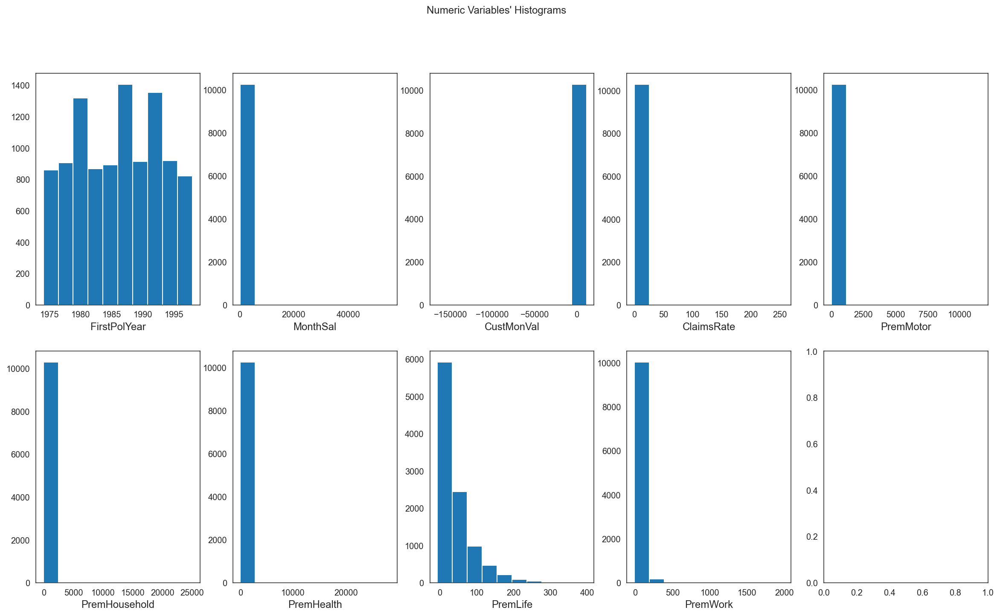

In [35]:
%matplotlib inline

sns.set_style("white")

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    ax.hist(data_consist[feat][~np.isnan(data_consist[feat])], bins=10)  
    ax.set_title(feat, y=-0.13)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title)

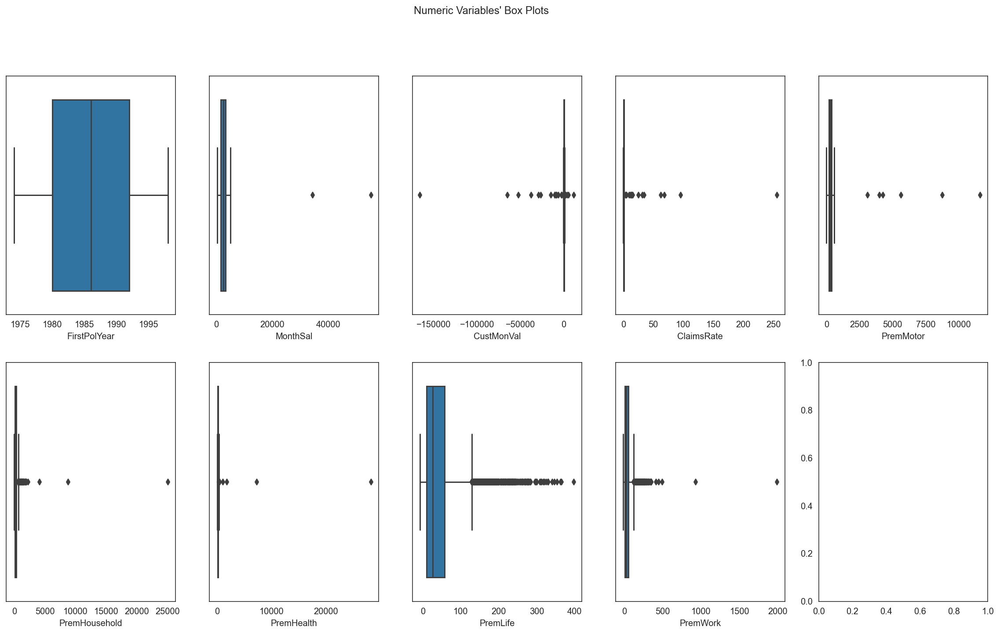

In [36]:
# All Numeric Variables' Box Plots in one figure
sns.set_style("white")

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=data_consist[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

#plt.savefig(os.path.join('..\DataMining_project_master.git/figures', 'box_plot_with_out'), dpi=200)
plt.show()


<a class="anchor" id="manual">

### Manual Filter
    
</a>

In [37]:
data_consist

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,
1.0,1985,2177.0,2,1,1,380.970001,0.39,375.850006,79.449997,146.360001,47.009998,16.889999
2.0,1981,677.0,2,4,1,-131.130005,1.12,77.459999,416.200012,116.690002,194.479996,106.129997
3.0,1991,2277.0,1,3,0,504.670013,0.28,206.149994,224.5,124.580002,86.349998,99.019997
4.0,1990,1099.0,3,4,1,-16.99,0.99,182.479996,43.349998,311.170013,35.34,28.34
5.0,1986,1763.0,3,4,1,35.23,0.9,338.619995,47.799999,182.589996,18.780001,41.450001
...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,1984,3188.0,4,2,0,-0.11,0.96,393.73999,49.450001,173.809998,9.78,14.78
10293.0,1977,2431.0,1,3,0,1405.599976,0.0,133.580002,1035.75,143.25,12.89,105.129997
10294.0,1994,2918.0,3,1,1,524.099976,0.21,403.630005,132.800003,142.25,12.67,4.89


In [38]:

filters1 = (
    
    ((data_consist['MonthSal']<=10000) | (data_consist['MonthSal'].isnull()))
    &
    ((data_consist['CustMonVal']>=-1250) | (data_consist['CustMonVal'].isnull()))
    &
    ((data_consist['CustMonVal']<1500) | (data_consist['CustMonVal'].isnull()))
    &
    ((data_consist['ClaimsRate']<=4)| (data_consist['ClaimsRate'].isnull()))
    &
    ((data_consist['PremMotor']<=2000)| (data_consist['PremMotor'].isnull()))
    &
    ((data_consist['PremHousehold']<=1600)| (data_consist['PremHousehold'].isnull()))
    &
    ((data_consist['PremHealth']<=800)| (data_consist['PremHealth'].isnull()))
    &
    ((data_consist['PremLife']<=200)| (data_consist['PremLife'].isnull()))
    &
    ((data_consist['PremWork']<=400)| (data_consist['PremWork'].isnull()))   
    
)

In [39]:
outliers = data_consist[~filters1]

In [40]:
data_consist=data_consist[filters1]

In [41]:
len(outliers)/len(data_treat)*100

1.8752429071123202

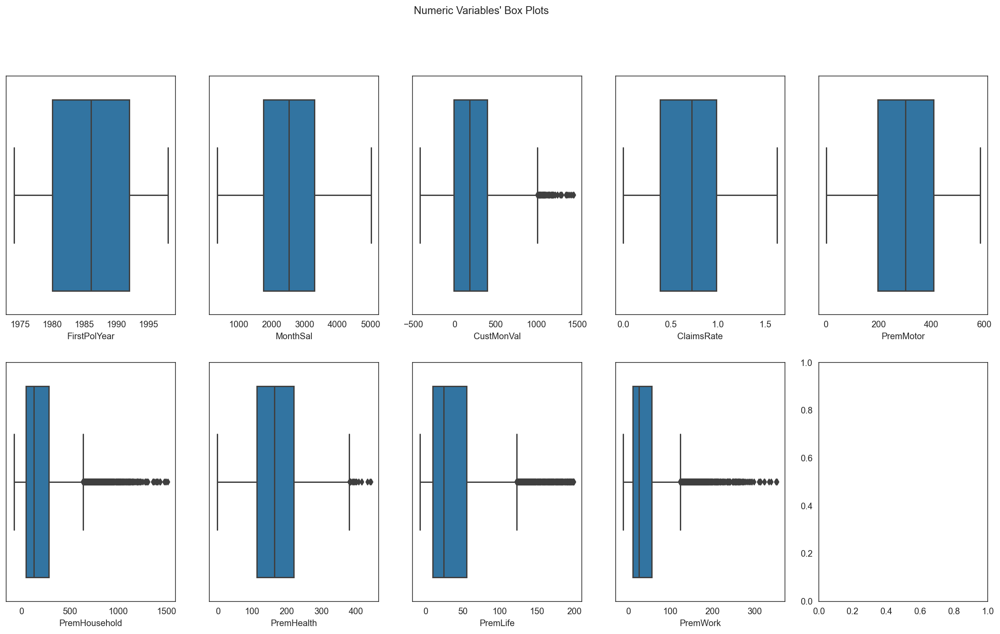

In [42]:
# All Numeric Variables' Box Plots in one figure
%matplotlib inline

sns.set_style("white")

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=data_consist[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

plt.show()

In [43]:
print('Percentage of outliers removed:', np.round((1-(data_consist.shape[0] / data_treat.shape[0]))*100,4))

#len(outliers)/len(data_treat)*100

Percentage of outliers removed: 1.8752


Text(0.5, 0.98, "Numeric Variables' Histograms")

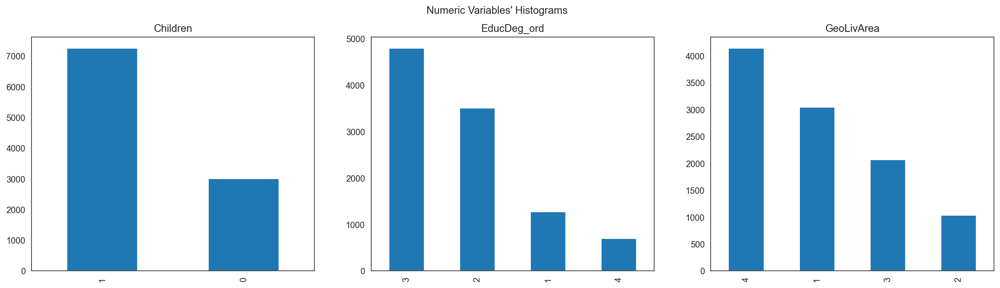

In [44]:
%matplotlib inline

sns.set_style("white")

# Prepare figure. Create individual axes where each histogram will be placed
fig, ax = plt.subplots(1, len(non_metric_features),figsize=(20, 5))

for i, categorical_feature in enumerate(data[non_metric_features]):
    data[categorical_feature].value_counts().plot(kind="bar", ax=ax[i]).set_title(categorical_feature)

# Add a centered title to the figure:
title = "Numeric Variables' Histograms"

plt.suptitle(title)

In [45]:
outliers=outliers[~outliers['PremMotor'].isna()]

In [46]:
data_consist.isna().sum()

FirstPolYear      30
MonthSal          36
EducDeg_ord       17
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         33
PremHousehold      0
PremHealth        42
PremLife         104
PremWork          86
dtype: int64

<a class="anchor" id="iqr">

### IQR Method
    
</a>

In [47]:
# def drop_outliers_IQR(df, iqr_mult,  metric_features):
#     filters2 = []
    
#     for metric in metric_features:
    
#         q25 = df[metric].quantile(.25)
#         q75 = df[metric].quantile(.75)
#         iqr = (q75 - q25)
#         upper_lim = q75 + (iqr_mult * iqr)
#         lower_lim = q25 - (iqr_mult * iqr)
#         filters2.append(df[metric].between(lower_lim, upper_lim, inclusive=True))

#     filters2 = pd.Series(np.all(filters2, 0), index=df.index)
#     data_2 = df[filters2]
   

#     return data_2

In [48]:
# drop_outliers_IQR(data_consist[metric_features][~np.isnan(data_consist['PremHousehold'])], 4 , ['PremHousehold'])


<a class="anchor" id="DBSCAN">

### DBSCAN
    
</a>


In [49]:
data_consist1=data_consist[~data_consist.isna().any(axis=1)]

In [50]:
neigh = NearestNeighbors(n_neighbors = 20)
nbrs = neigh.fit(data_consist1[metric_features])
distances, indices = nbrs.kneighbors(data_consist1[metric_features])
distances

array([[  0.        ,  49.8129387 ,  55.39123307, ...,  98.21419954,
         99.63382104,  99.86471103],
       [  0.        , 163.81056701, 176.22160044, ..., 258.72137003,
        262.96477827, 263.37639811],
       [  0.        , 127.68280324, 153.5459063 , ..., 201.49915037,
        202.04476988, 202.22660819],
       ...,
       [  0.        ,  48.5478726 ,  51.91696587, ..., 101.62859263,
        102.51288275, 104.82203129],
       [  0.        , 101.86842263, 110.39787736, ..., 145.05676802,
        150.01422072, 150.10621703],
       [  0.        ,  37.81051196,  41.47668562, ...,  83.25916476,
         83.63186623,  84.28501946]])

[ 54.63612393  56.84024953  57.40574855 ... 699.12976639 720.58127038
 819.26065819]


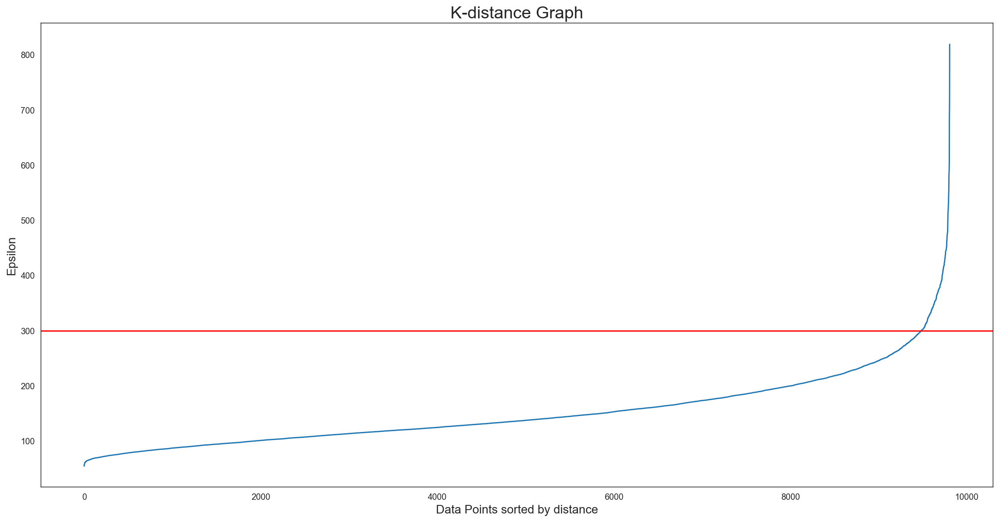

In [51]:
%matplotlib inline
sns.set_style("white")
distances1 =  np.sort(distances[:, -1])
print(distances1)
plt.figure(figsize=(20,10))
plt.plot(distances1)
plt.title('K-distance Graph',fontsize=20)
plt.xlabel('Data Points sorted by distance',fontsize=14)
plt.ylabel('Epsilon',fontsize=14)
plt.axhline(y=300, color='r', linestyle='-')
# plt.xlim([8000, 11000])
# plt.ylim([0, 2500])
plt.show()

In [52]:
dbscan_opt = DBSCAN(eps = 300, min_samples=18,n_jobs=-1)
dbscan_labels=dbscan_opt.fit_predict(data_consist1[metric_features])

In [53]:
data_dbscan = data_consist1[metric_features].copy()
data_dbscan['DBSCAN_opt_labels'] = dbscan_opt.labels_
data_dbscan['DBSCAN_opt_labels'].value_counts()

 0    9757
-1      48
Name: DBSCAN_opt_labels, dtype: int64

In [54]:
# Concatenating the labels to df
df_concat = pd.concat([data_consist1, pd.Series(dbscan_labels, index=data_consist1.index, name="dbscan_labels")], axis=1)
df_concat

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,dbscan_labels
CustID,,,,,,,,,,,,,
1.0,1985,2177.0,2,1,1,380.970001,0.39,375.850006,79.449997,146.360001,47.009998,16.889999,0
2.0,1981,677.0,2,4,1,-131.130005,1.12,77.459999,416.200012,116.690002,194.479996,106.129997,0
3.0,1991,2277.0,1,3,0,504.670013,0.28,206.149994,224.5,124.580002,86.349998,99.019997,0
4.0,1990,1099.0,3,4,1,-16.99,0.99,182.479996,43.349998,311.170013,35.34,28.34,0
5.0,1986,1763.0,3,4,1,35.23,0.9,338.619995,47.799999,182.589996,18.780001,41.450001,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10292.0,1984,3188.0,4,2,0,-0.11,0.96,393.73999,49.450001,173.809998,9.78,14.78,0
10293.0,1977,2431.0,1,3,0,1405.599976,0.0,133.580002,1035.75,143.25,12.89,105.129997,-1
10294.0,1994,2918.0,3,1,1,524.099976,0.21,403.630005,132.800003,142.25,12.67,4.89,0


In [55]:
outliers = pd.concat([outliers, df_concat[df_concat['dbscan_labels'] == -1]]).drop(columns = {'dbscan_labels'})
len(outliers)/len(data_treat)*100

2.331908278274388

In [56]:
# Detecting noise (potential outliers)
df_concat.loc[df_concat['dbscan_labels'] == -1]

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,dbscan_labels
CustID,,,,,,,,,,,,,
909.0,1981,1917.0,3,3,1,1254.23999,0.0,129.580002,869.049988,209.039993,11.78,59.790001,-1
1355.0,1976,613.0,1,1,1,231.270004,0.83,11.78,1201.900024,78.57,67.790001,188.479996,-1
1464.0,1977,2685.0,1,3,0,-25.0,1.0,52.900002,931.299988,140.470001,30.34,156.919998,-1
1554.0,1987,3139.0,1,4,1,-116.239998,1.06,102.019997,1216.900024,64.790001,91.239998,79.57,-1
1860.0,1997,1159.0,1,1,1,1382.27002,0.16,30.34,1364.150024,104.019997,78.57,91.349998,-1
1913.0,1977,2317.0,1,1,1,1010.73999,0.3,55.009998,1090.75,198.259995,110.019997,30.450001,-1
1938.0,1990,3735.0,2,4,1,1150.319946,0.16,201.259995,982.950012,174.809998,8.89,36.450001,-1
2531.0,1979,1273.0,1,3,1,1428.930054,0.19,66.57,1513.050049,99.129997,97.239998,28.450001,-1
2546.0,1977,694.0,2,4,1,174.259995,0.88,105.019997,1277.449951,141.360001,8.89,94.239998,-1


In [57]:
# Computing the R^2 of the cluster solution
df_nonoise = df_concat.loc[df_concat['dbscan_labels'] != -1]


In [58]:
df_nonoise

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,dbscan_labels
CustID,,,,,,,,,,,,,
1.0,1985,2177.0,2,1,1,380.970001,0.39,375.850006,79.449997,146.360001,47.009998,16.889999,0
2.0,1981,677.0,2,4,1,-131.130005,1.12,77.459999,416.200012,116.690002,194.479996,106.129997,0
3.0,1991,2277.0,1,3,0,504.670013,0.28,206.149994,224.5,124.580002,86.349998,99.019997,0
4.0,1990,1099.0,3,4,1,-16.99,0.99,182.479996,43.349998,311.170013,35.34,28.34,0
5.0,1986,1763.0,3,4,1,35.23,0.9,338.619995,47.799999,182.589996,18.780001,41.450001,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10291.0,1994,626.0,1,3,1,176.259995,0.85,6.89,878.5,103.129997,113.019997,201.259995,0
10292.0,1984,3188.0,4,2,0,-0.11,0.96,393.73999,49.450001,173.809998,9.78,14.78,0
10294.0,1994,2918.0,3,1,1,524.099976,0.21,403.630005,132.800003,142.25,12.67,4.89,0


In [59]:
data_missings=data_consist[data_consist.isna().any(axis=1)]

In [60]:
data_consist = pd.concat([data_missings, df_nonoise], axis=0)
data_consist = data_consist.drop(columns = {'dbscan_labels'})
data_consist

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,
22.0,1977,NaN,2,3,1,111.370003,0.8,407.519989,111.699997,100.129997,24.67,30.34
69.0,1983,1399.0,2,4,1,476.649994,0.33,330.730011,186.699997,211.149994,<NA>,15.78
139.0,1979,2538.0,2,2,1,149.589996,0.69,194.259995,305.600006,<NA>,37.34,17.67
144.0,1996,NaN,3,4,1,-42.450001,1.02,146.360001,353.950012,220.039993,121.800003,42.009998
185.0,1993,2419.0,2,4,1,-62.23,1.07,<NA>,253.949997,230.600006,5.89,43.119999
...,...,...,...,...,...,...,...,...,...,...,...,...
10291.0,1994,626.0,1,3,1,176.259995,0.85,6.89,878.5,103.129997,113.019997,201.259995
10292.0,1984,3188.0,4,2,0,-0.11,0.96,393.73999,49.450001,173.809998,9.78,14.78
10294.0,1994,2918.0,3,1,1,524.099976,0.21,403.630005,132.800003,142.25,12.67,4.89


In [61]:
(len(data_treat)-len(data_consist))/(len(data_treat))

0.02341624562767198

In [62]:
data_consist.isna().sum()

FirstPolYear      30
MonthSal          36
EducDeg_ord       17
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         33
PremHousehold      0
PremHealth        42
PremLife         104
PremWork          86
dtype: int64

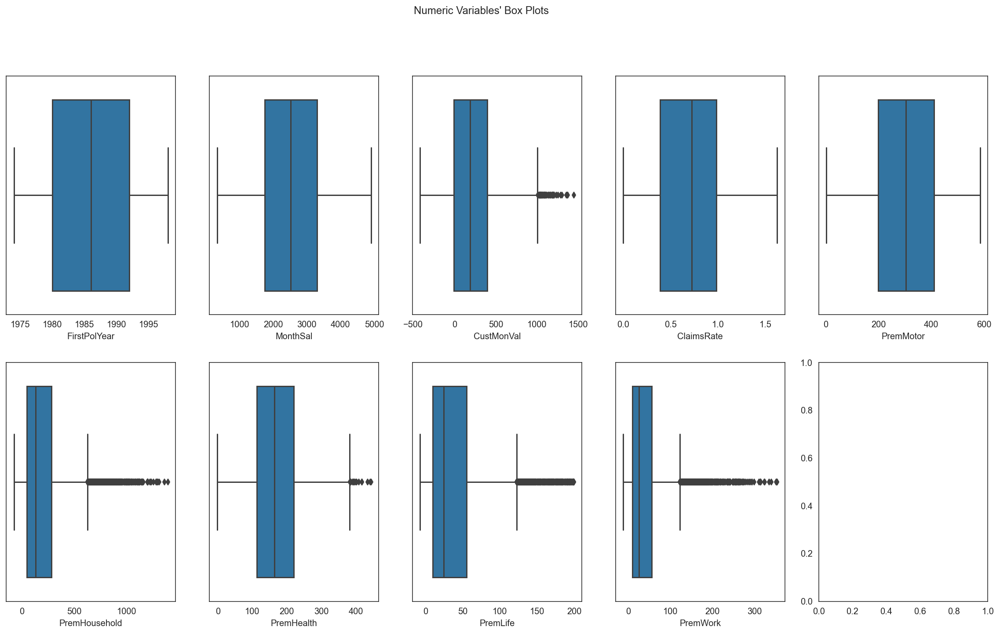

In [63]:
# All Numeric Variables' Box Plots in one figure
%matplotlib inline

sns.set_style("white")

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=data_consist[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

plt.show()

In [64]:
filters2=(
            ((data_consist['PremWork']<=300) | (data_consist['PremWork'].isnull())) &
            ((data_consist['PremHealth']<450) | (data_consist['PremHealth'].isnull()))&
            ((data_consist['PremHousehold']<1250) | (data_consist['PremHousehold'].isnull()))
            )

data_consist=data_consist[filters2]

In [65]:
outliers.shape

(240, 12)

In [66]:
print('Percentage of outliers removed:', np.round((len(data_treat)-len(data_consist))/len(data_treat)*100,4))

Percentage of outliers removed: 2.536


In [67]:
outliers.isna().sum()

FirstPolYear     0
MonthSal         0
EducDeg_ord      0
GeoLivArea       0
Children         0
CustMonVal       0
ClaimsRate       0
PremMotor        0
PremHousehold    0
PremHealth       0
PremLife         0
PremWork         0
dtype: int64

<a class="anchor" id="multi-outliers">

### Multi-dimentional outliers
    
</a>

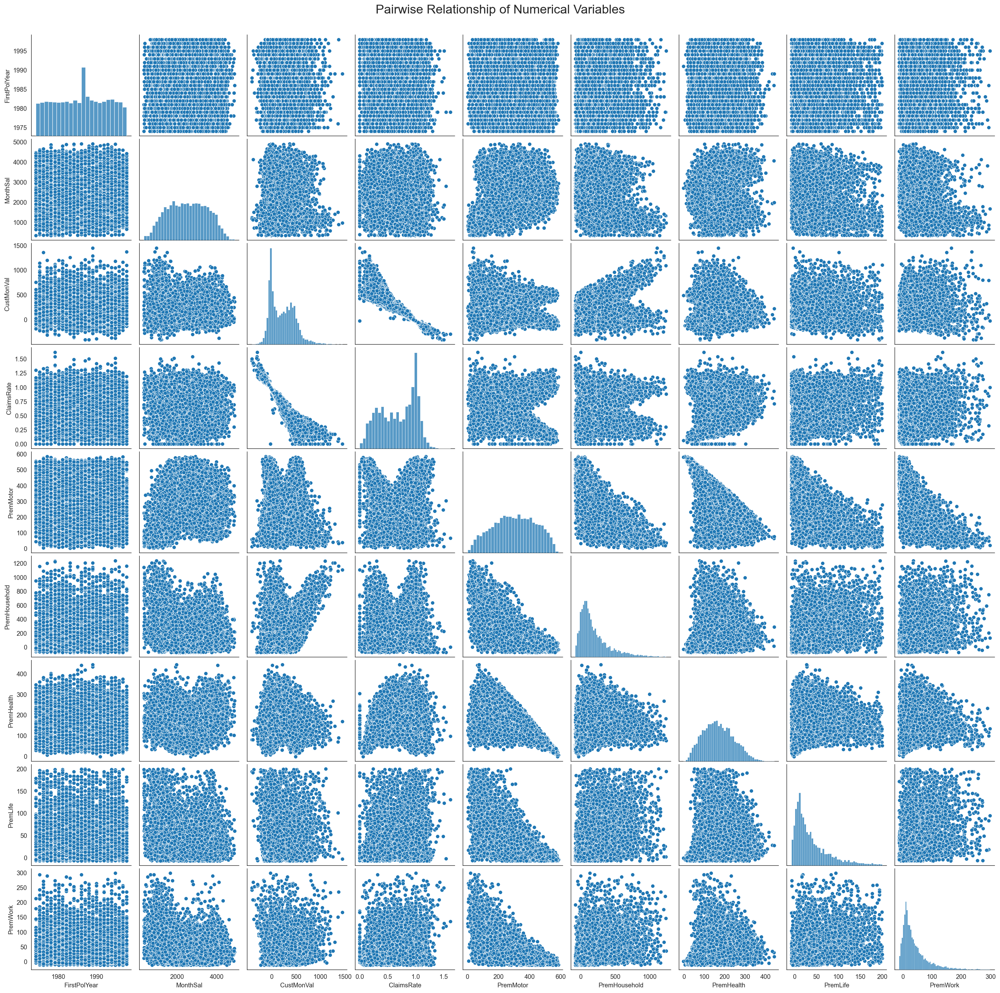

In [68]:
# Pairwise Relationship of Numerical Variables

# Setting pairplot
sns.pairplot(data_consist[metric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

In [69]:
data_out_rmv=data_consist.copy()


<a class="anchor" id="scale1">

## Scale the data
    
</a>

In [70]:
# scale the data before the missing values imputation due to KNN
# Use MinMaxScaler to scale the data

scaler=MinMaxScaler().fit(data_out_rmv[metric_features])
data_out_rmv[metric_features] = pd.DataFrame(scaler.transform(data_out_rmv[metric_features]), columns = metric_features).set_index(data_out_rmv[metric_features].index)

outliers[metric_features] = pd.DataFrame(scaler.transform(outliers[metric_features]), columns = metric_features).set_index(outliers[metric_features].index)

In [71]:
data_out_rmv[metric_features].describe().T

,count,mean,std,min,25%,50%,75%,max
FirstPolYear,10001.0,0.500917,0.275161,0.0,0.250000,0.500000,0.750000,1.0
MonthSal,9995.0,0.478759,0.212548,0.0,0.309342,0.479982,0.648873,1.0
CustMonVal,10031.0,0.334730,0.133604,0.0,0.214040,0.319487,0.433354,1.0
ClaimsRate,10031.0,0.419772,0.195908,0.0,0.240741,0.444444,0.604938,1.0
PremMotor,9998.0,0.515079,0.231294,0.0,0.340189,0.518288,0.698855,1.0
PremHousehold,10031.0,0.206861,0.164742,0.0,0.094364,0.155293,0.270830,1.0
PremHealth,9989.0,0.384504,0.166894,0.0,0.258242,0.373126,0.499247,1.0
PremLife,9928.0,0.220869,0.195050,0.0,0.081843,0.153462,0.300480,1.0
PremWork,9945.0,0.166815,0.143932,0.0,0.070853,0.120612,0.215813,1.0


In [72]:
outliers[metric_features].describe().T

,count,mean,std,min,25%,50%,75%,max
FirstPolYear,240.0,0.503125,0.286283,0.000000,0.239583,0.541667,0.750000,1.000000
MonthSal,240.0,0.366963,0.917443,0.000438,0.118738,0.198315,0.442135,12.006563
CustMonVal,240.0,-0.523493,6.778460,-89.127915,0.205441,0.328565,0.548193,6.623323
ClaimsRate,240.0,2.071271,11.633702,0.000000,0.197531,0.462963,0.617284,158.148155
PremMotor,240.0,0.419839,1.844113,-0.010095,0.059235,0.104381,0.192616,19.886604
PremHousehold,240.0,0.625005,1.330288,0.030465,0.206188,0.410282,0.775933,19.134654
PremHealth,240.0,0.644949,4.218933,0.071173,0.192429,0.280221,0.364884,63.541612
PremLife,240.0,0.882315,0.491326,0.004846,0.359851,1.061928,1.204099,1.963948
PremWork,240.0,0.318804,0.494292,0.003221,0.110411,0.225298,0.390741,6.443478


<a class="anchor" id="missings">

## Missing Values
    
</a>

In [73]:
# Checking maximum number of nan in a record
maxi=0
ind_max=[]

for i, v in enumerate(data_out_rmv):

    if data_out_rmv.iloc[i,:].isna().sum()>maxi:
        maxi=data_out_rmv.iloc[i,:].isna().sum()

for i, v in enumerate(data_out_rmv):
    if data_out_rmv.iloc[i,:].isna().sum()==maxi:
        ind_max.append(i)
        
print(maxi,ind_max)

#decided not to drop the records since there are many more features.

3 [6, 11]


In [74]:
data_out_rmv.iloc[11]

FirstPolYear        0.125
MonthSal             <NA>
EducDeg_ord           3.0
GeoLivArea            3.0
Children              0.0
CustMonVal       0.190638
ClaimsRate        0.67284
PremMotor            <NA>
PremHousehold    0.057121
PremHealth       0.631368
PremLife             <NA>
PremWork         0.127407
Name: 489.0, dtype: Float64

In [75]:
check_nan_feature=pd.DataFrame(data_out_rmv.isna().sum()).rename(columns={0:'Nr_missings'})
#check_nan_feature.columns.values[0]="Nr_missings"
print(check_nan_feature)
check_nan_feature['perc']=check_nan_feature['Nr_missings']/len(data_out_rmv) *100

               Nr_missings
FirstPolYear            30
MonthSal                36
EducDeg_ord             17
GeoLivArea               1
Children                21
CustMonVal               0
ClaimsRate               0
PremMotor               33
PremHousehold            0
PremHealth              42
PremLife               103
PremWork                86


In [76]:
check_nan_feature
# there is no feature with more than 20% of nan values-- no feature will be removed

,Nr_missings,perc
FirstPolYear,30,0.299073
MonthSal,36,0.358887
EducDeg_ord,17,0.169475
GeoLivArea,1,0.009969
Children,21,0.209351
CustMonVal,0,0.000000
ClaimsRate,0,0.000000
PremMotor,33,0.328980
PremHousehold,0,0.000000
PremHealth,42,0.418702


### Premiums missings treatment

In [77]:
# Filled nan values in insurance expenses with 0
data_out_rmv['PremMotor'].fillna(0, inplace = True)
data_out_rmv['PremHealth'].fillna(0, inplace = True)
data_out_rmv['PremLife'].fillna(0, inplace = True)
data_out_rmv['PremWork'].fillna(0, inplace = True)

<a class="anchor" id="mode_missing">

## Mode
    
</a>

### GeoLivArea missings treatment

In [78]:
data_out_rmv['GeoLivArea'].value_counts()

4    4031
1    2977
3    2013
2    1009
Name: GeoLivArea, dtype: Int64

In [79]:
mode_geo = data['GeoLivArea'].mode().loc[0]
data_out_rmv['GeoLivArea'].fillna(mode_geo, inplace=True)

In [80]:
data_out_rmv.isna().sum()

FirstPolYear     30
MonthSal         36
EducDeg_ord      17
GeoLivArea        0
Children         21
CustMonVal        0
ClaimsRate        0
PremMotor         0
PremHousehold     0
PremHealth        0
PremLife          0
PremWork          0
dtype: int64

In [81]:
#data_out_rmv=data_out_rmv[~((data_out_rmv['FirstPolYear'].isna()) & (data_out_rmv['BirthYear'].isna()))]

<a class="anchor" id="KNN_missing">

## KNN
    
</a>

### MonthSal and FirstPolYear missings treatment - KNNImputer

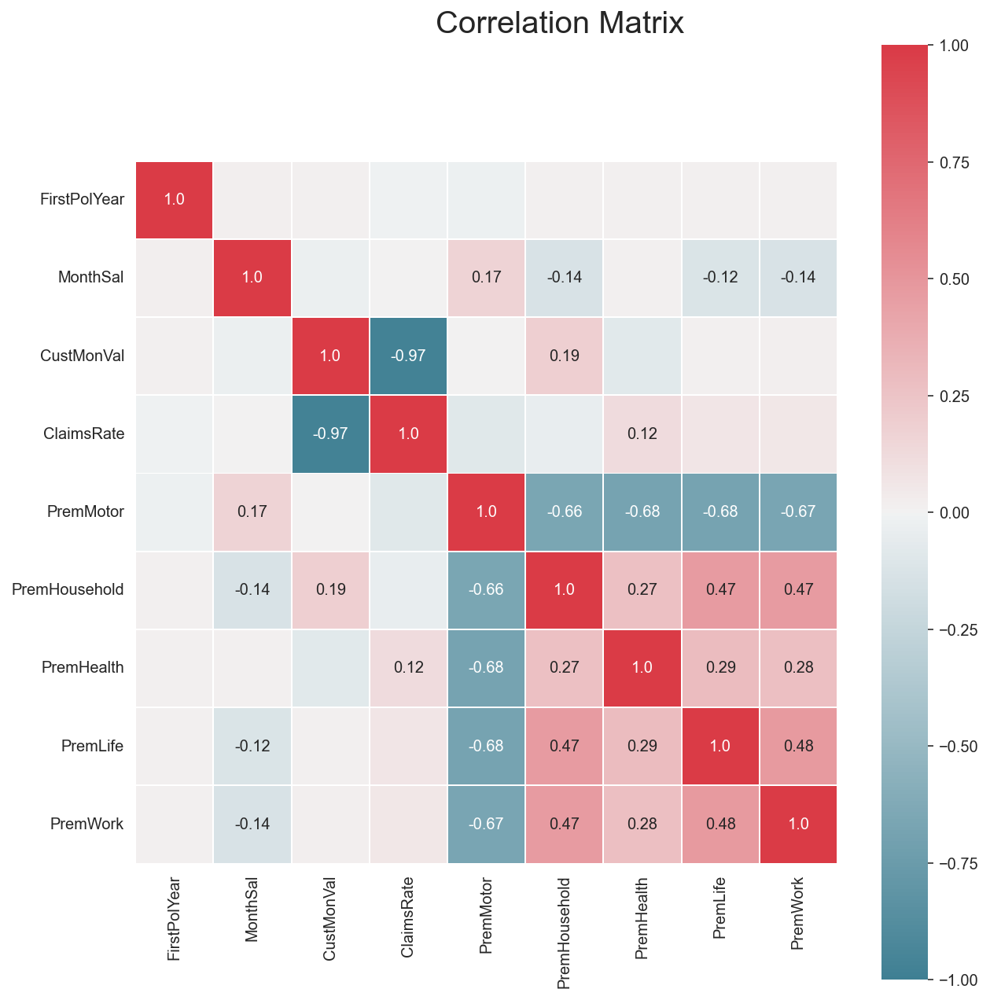

In [163]:
# Prepare figure
fig = plt.figure(figsize=(10, 10))

# Obtain correlation matrix. Round the values to 2 decimal cases.
corr = np.round(data_out_rmv[metric_features].corr(method="spearman"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.1
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

#plt.savefig(os.path.join('..', 'figures', 'correlation_matrix.png'), dpi=200)

plt.show()

In [83]:
# KNNImputer - only works for numerical variables
imputer = KNNImputer(n_neighbors=5, weights="distance")
prem_list=['PremMotor','PremHousehold','PremLife','PremWork','MonthSal','FirstPolYear']
data_out_rmv[prem_list]=imputer.fit_transform(data_out_rmv[prem_list])

In [84]:
data_out_rmv.isna().sum()

FirstPolYear      0
MonthSal          0
EducDeg_ord      17
GeoLivArea        0
Children         21
CustMonVal        0
ClaimsRate        0
PremMotor         0
PremHousehold     0
PremHealth        0
PremLife          0
PremWork          0
dtype: int64

### EducDeg_ord missings treatment - KNNClassifier

In [85]:
data_out_rmv['EducDeg_ord'].value_counts()

3    4771
2    3424
1    1123
4     696
Name: EducDeg_ord, dtype: Int64

In [86]:
# # Pairwise Relationship of Numerical Variables
# sns.set()
# educ_vals = data_out_rmv.EducDeg_ord.dropna()
# # Setting pairplot
# sns.pairplot(data_out_rmv[metric_features + ['EducDeg_ord']], diag_kind="hist", hue='EducDeg_ord')
# # Layout
# plt.subplots_adjust(top=0.95)
# plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
# plt.show()

In [87]:
def metrics_def(y_train, pred_train , y_val, pred_val):
    print('___________________________________________________________________________________________________________')
    print('                                                     TRAIN                                                 ')
    print('-----------------------------------------------------------------------------------------------------------')
    print(classification_report(y_train, pred_train))
    print(confusion_matrix(y_train, pred_train))


    print('___________________________________________________________________________________________________________')
    print('                                                VALIDATION                                                 ')
    print('-----------------------------------------------------------------------------------------------------------')
    print(classification_report(y_val, pred_val))
    print(confusion_matrix(y_val, pred_val))

In [88]:
missings_educ = data_out_rmv[data_out_rmv['EducDeg_ord'].isna()].drop(['EducDeg_ord','Children'], axis=1)
input_data_educ = data_out_rmv[~data_out_rmv['EducDeg_ord'].isna()]

X_knn_educ = input_data_educ.drop(['EducDeg_ord','Children'], axis=1)[['MonthSal','PremHousehold','PremMotor','CustMonVal']]
y_knn_educ = input_data_educ['EducDeg_ord']
y_knn_educ = y_knn_educ.astype('int')

In [89]:
X_train_knn_educ, X_val_knn_educ, y_train_knn_educ, y_val_knn_educ = train_test_split(X_knn_educ, y_knn_educ, train_size=0.7, stratify = y_knn_educ, random_state=5,shuffle=True)

# oversample = SMOTE()
# X_over_educ, y_over_educ = oversample.fit_resample(X_train_knn_educ, y_train_knn_educ)

In [90]:
# from collections import Counter
# print('Resampled dataset shape %s' % Counter(y_over_educ))

In [91]:
modelKNN = KNeighborsClassifier(n_neighbors=7)
#modelKNN.fit(X = X_over_educ, y = y_over_educ)
modelKNN.fit(X = X_train_knn_educ, y = y_train_knn_educ)

KNeighborsClassifier(n_neighbors=7)

In [92]:
labels_train = modelKNN.predict(X_train_knn_educ)
labels_val = modelKNN.predict(X_val_knn_educ)
labels_val

array([3, 2, 3, ..., 2, 2, 2])

In [93]:
target_names = ['class 1', 'class 2', 'class 3','class 4']
metrics_def(y_train_knn_educ, labels_train , y_val_knn_educ, labels_val)

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           1       0.57      0.37      0.44       786
           2       0.57      0.60      0.59      2397
           3       0.65      0.76      0.70      3339
           4       0.58      0.09      0.15       487

    accuracy                           0.62      7009
   macro avg       0.59      0.45      0.47      7009
weighted avg       0.61      0.62      0.60      7009

[[ 287  294  201    4]
 [ 134 1449  804   10]
 [  78  708 2536   17]
 [   7   96  342   42]]
___________________________________________________________________________________________________________
                                        

In [94]:
#modelKNN.kneighbors(X = X_val_knn_educ)

In [95]:
imputed_educ= modelKNN.predict(missings_educ[['MonthSal','PremHousehold','PremMotor','CustMonVal']])
imputed_educ

array([3, 3, 3, 2, 3, 3, 3, 3, 3, 2, 2, 3, 3, 3, 2, 3, 2])

In [96]:
teste=data_out_rmv[data_out_rmv['EducDeg_ord'].isna()]

In [97]:
teste['EducDeg_ord']=imputed_educ

C:\Users\UTILIZ~1\AppData\Local\Temp/ipykernel_30984/4193100922.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  teste['EducDeg_ord']=imputed_educ


In [98]:
data_out_rmv=pd.concat([input_data_educ,teste])

In [99]:
data_out_rmv.isna().sum()

FirstPolYear      0
MonthSal          0
EducDeg_ord       0
GeoLivArea        0
Children         21
CustMonVal        0
ClaimsRate        0
PremMotor         0
PremHousehold     0
PremHealth        0
PremLife          0
PremWork          0
dtype: int64

<a class="anchor" id="logistic_missing">

## Logistic Regression
    
</a>

### Children missings treatment

In [100]:
input_data=data_out_rmv.copy()

In [101]:
input_data.isna().sum()

FirstPolYear      0
MonthSal          0
EducDeg_ord       0
GeoLivArea        0
Children         21
CustMonVal        0
ClaimsRate        0
PremMotor         0
PremHousehold     0
PremHealth        0
PremLife          0
PremWork          0
dtype: int64

In [102]:
missings_children= input_data[input_data['Children'].isna()].drop('Children', axis=1)
input_data_log=input_data[~input_data['Children'].isna()]
X_input_data_log=input_data_log.drop('Children', axis=1)[['PremLife','PremWork','MonthSal']]
y_log=pd.DataFrame(input_data_log['Children'])
y_log=y_log.astype('int')

X_train_log, X_val_log,y_train_log,y_val_log = train_test_split(X_input_data_log,y_log,test_size=0.2,random_state=5, stratify=y_log)

lr = LogisticRegression(random_state=42)
lr.fit(X_train_log,y_train_log)

C:\Users\Utilizador\anaconda3\envs\datamining\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


LogisticRegression(random_state=42)

In [103]:
input_data_log=input_data[~input_data['Children'].isna()]
X_input_data_log=input_data_log.drop('Children', axis=1)
X_input_data_log[['PremLife','PremWork','MonthSal']]

,PremLife,PremWork,MonthSal
CustID,,,
22.0,0.153462,0.136361,0.591337
69.0,0.000000,0.089469,0.233209
139.0,0.214857,0.095556,0.482389
144.0,0.624122,0.173945,0.141107
185.0,0.062461,0.177520,0.456355
...,...,...,...
8174.0,0.276784,0.262705,0.842266
8304.0,0.090469,0.107729,0.742945
9137.0,0.828221,0.554042,0.310654


In [104]:
y_pred_val_log = lr.predict(X_val_log)


In [105]:
y_pred_train_log = lr.predict(X_train_log)

# no overfitting -- f1 score from validation is similar with f1 score for train

In [106]:
metrics_def(y_train_log,y_pred_train_log,y_val_log,y_pred_val_log)
# no overfitting

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           0       0.73      0.57      0.64      2330
           1       0.84      0.91      0.87      5678

    accuracy                           0.81      8008
   macro avg       0.78      0.74      0.76      8008
weighted avg       0.81      0.81      0.81      8008

[[1330 1000]
 [ 499 5179]]
___________________________________________________________________________________________________________
                                                VALIDATION                                                 
----------------------------------------------------------------------------------------------------------

In [107]:
imputed_children= lr.predict(missings_children[['PremLife','PremWork','MonthSal']])
imputed_children

array([1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0])

In [108]:
missings_children['Children']=imputed_children

In [109]:
data_out_rmv=pd.concat([input_data_log,missings_children])

In [110]:
data_out_miss=data_out_rmv.copy()

In [111]:
data_out_miss.isna().sum()

FirstPolYear     0
MonthSal         0
EducDeg_ord      0
GeoLivArea       0
Children         0
CustMonVal       0
ClaimsRate       0
PremMotor        0
PremHousehold    0
PremHealth       0
PremLife         0
PremWork         0
dtype: int64


<a class="anchor" id="eng">

### 2.4. Feature Engineering
    
</a>


In [112]:
max_polyear=np.max(data_consist['FirstPolYear'])
min_polyear=np.min(data_consist['FirstPolYear'])

new_year=(2016-min_polyear)/(max_polyear-min_polyear)

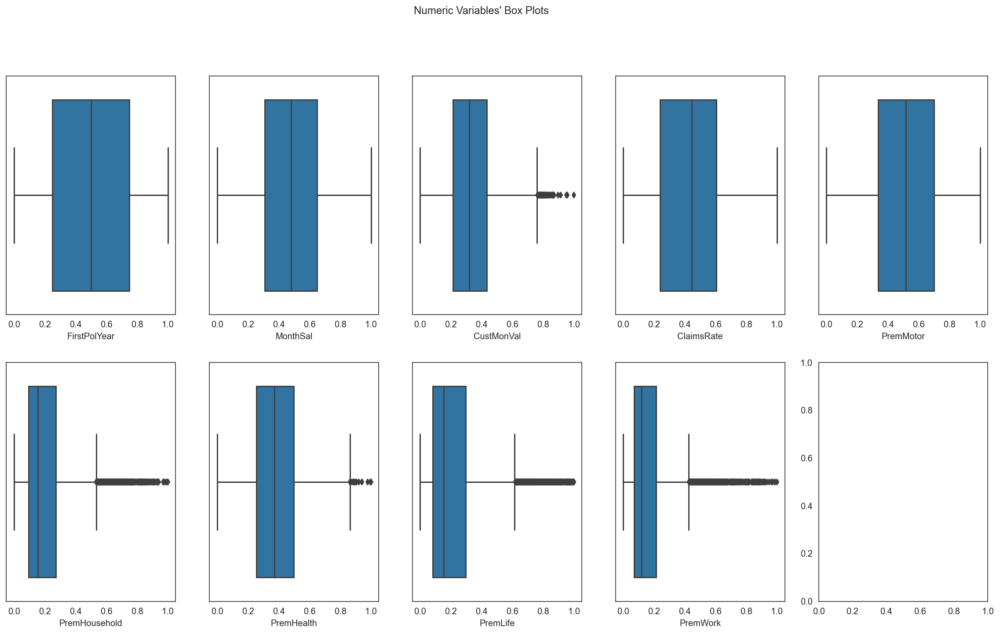

In [113]:
# All Numeric Variables' Box Plots in one figure
# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=data_out_miss[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots"

plt.suptitle(title)

plt.show()

In [114]:
# ver numeros negativos em PREM
def feat_eng(df, date_df, year):
        df['year_cust']=year-date_df['FirstPolYear']
        df['log_custMon']=np.log10(df['CustMonVal']+1)
        #data_out_miss['log_claims']=np.log10(data_out_miss['ClaimsRate'])
        #data_out_miss['log_health']=np.log10(data_out_miss['PremHealth']+1)
        df['log_household']=np.log10(df['PremHousehold']+1)
        df['log_life']=np.log10(df['PremLife']+1)
        #data_out_miss['log_motor']=np.log10(data_out_miss['PremMotor'])
        df['log_work']=np.log10(df['PremWork']+1)

        df['AnnualSal']=df['MonthSal']*12

        df['perc_inc_health']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremHealth'],df['AnnualSal']) )
        
        df['perc_inc_household']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremHousehold'],df['AnnualSal']) )

        df['perc_inc_life']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremLife'],df['AnnualSal']) )

        df['perc_inc_motor']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremMotor'],df['AnnualSal']) )
        df['perc_inc_work']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremWork'],df['AnnualSal']) )
        df['annual_profit']=df['CustMonVal']/df['year_cust']
        df['Total_Premiums']=df.loc[:,['PremMotor','PremHousehold','PremHealth','PremLife','PremWork']][df>0].sum(1)
        df['anual_claims_rate'] = df['ClaimsRate']/2

        return df

In [115]:
data_out_miss = feat_eng(data_out_miss, data_out_rmv, new_year)

In [116]:
# ver numeros negativos em PREM
def feat_eng_out(df, date_df, year):
        df['year_cust']=year-date_df['FirstPolYear']
        df['log_custMon']=np.log10(df['CustMonVal']-min(df['CustMonVal'])+1)
        #data_out_miss['log_claims']=np.log10(data_out_miss['ClaimsRate'])
        #data_out_miss['log_health']=np.log10(data_out_miss['PremHealth']+1)
        df['log_household']=np.log10(df['PremHousehold']+1)
        df['log_life']=np.log10(df['PremLife']+1)
        #data_out_miss['log_motor']=np.log10(data_out_miss['PremMotor'])
        df['log_work']=np.log10(df['PremWork']+1)

        df['AnnualSal']=df['MonthSal']*12

        df['perc_inc_health']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremHealth'],df['AnnualSal']) )
        
        df['perc_inc_household']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremHousehold'],df['AnnualSal']) )

        df['perc_inc_life']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremLife'],df['AnnualSal']) )

        df['perc_inc_motor']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremMotor'],df['AnnualSal']) )
        df['perc_inc_work']=np.where(
                df['AnnualSal']==0, 0,np.divide(df['PremWork'],df['AnnualSal']) )
        df['annual_profit']=df['CustMonVal']/df['year_cust']
        df['Total_Premiums']=df.loc[:,['PremMotor','PremHousehold','PremHealth','PremLife','PremWork']][df>0].sum(1)
        df['anual_claims_rate'] = df['ClaimsRate']/2

        return df

In [117]:
outliers=feat_eng_out(outliers, outliers, new_year)

In [118]:
outliers.isna().sum()

FirstPolYear          0
MonthSal              0
EducDeg_ord           0
GeoLivArea            0
Children              0
CustMonVal            0
ClaimsRate            0
PremMotor             0
PremHousehold         0
PremHealth            0
PremLife              0
PremWork              0
year_cust             0
log_custMon           0
log_household         0
log_life              0
log_work              0
AnnualSal             0
perc_inc_health       0
perc_inc_household    0
perc_inc_life         0
perc_inc_motor        0
perc_inc_work         0
annual_profit         0
Total_Premiums        0
anual_claims_rate     0
dtype: int64

# Redo Scaling

In [119]:
# # Use MinMaxScaler to scale the data
# #scaler = RobustScaler()
# scaling_columns = data_out_miss.drop(non_metric_features, axis = 1).columns.to_list()
# scaler=MinMaxScaler()
# data_out_rmv[scaling_columns] = scaler.fit(data_out_miss.drop(non_metric_features,axis=1))
# data_out_rmv[scaling_columns] = pd.DataFrame(scaler.transform(data_out_miss.drop(non_metric_features, axis = 1)), columns = scaling_columns).set_index(data_out_miss[scaling_columns].index)
# outliers = pd.DataFrame(scaler.transform(outliers.drop(non_metric_features, axis = 1)), columns = scaling_columns).set_index(outliers[scaling_columns].index)

In [120]:
# data_out_rmv[scaling_columns].describe().T

In [121]:
# scaling_columns = data_out_miss.drop(non_metric_features, axis = 1).columns.to_list()
# data_out_rmv[scaling_columns] = data_out_miss[scaling_columns]
# data_out_rmv[scaling_columns]

### One-hot Encoding

In [122]:
ohc_feat_list = ['EducDeg_ord', 'GeoLivArea']

In [123]:
data_ohc = data_out_rmv.copy()

In [124]:
# Use OneHotEncoder to encode the categorical features. Get feature names and create a DataFrame 
# with the one-hot encoded categorical features (pass feature names)
ohc = OneHotEncoder(sparse = False)
ohc_feat = ohc.fit_transform(data_ohc[ohc_feat_list])
ohc_feat_names = ohc.get_feature_names()
ohc_df = pd.DataFrame(ohc_feat, index = data_ohc.index, columns = ohc_feat_names) 
ohc_df

,x0_1,x0_2,x0_3,x0_4,x1_1,x1_2,x1_3,x1_4
CustID,,,,,,,,
22.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
69.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
139.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
144.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
185.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...
8019.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
8375.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
8420.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


In [125]:
ohc_df.rename(columns={'x0_1':'EducDeg_ord1','x0_2':'EducDeg_ord2','x0_3':'EducDeg_ord3','x0_4':'EducDeg_ord4','x1_1' : 'GeoLivArea_1', 'x1_2':'GeoLivArea_2', 'x1_3':'GeoLivArea_3', 'x1_4':'GeoLivArea_4'},inplace=True)

In [126]:
data_ohc = pd.concat([data_ohc.drop(columns = ohc_feat_list), ohc_df], axis=1)
data_ohc

,FirstPolYear,MonthSal,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,EducDeg_ord1,EducDeg_ord2,EducDeg_ord3,EducDeg_ord4,GeoLivArea_1,GeoLivArea_2,GeoLivArea_3,GeoLivArea_4
CustID,,,,,,,,,,,,,,,,,,
22.0,0.125000,0.591337,1,0.279041,0.493827,0.695427,0.142193,0.229768,0.153462,0.136361,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
69.0,0.375000,0.233209,1,0.476027,0.203704,0.563811,0.199315,0.479268,0.000000,0.089469,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
139.0,0.208333,0.482389,1,0.299652,0.425926,0.329905,0.289871,0.000000,0.214857,0.095556,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
144.0,0.916667,0.141107,1,0.196090,0.629630,0.247806,0.326695,0.499247,0.624122,0.173945,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
185.0,0.791667,0.456355,1,0.185423,0.660494,0.000000,0.250533,0.522979,0.062461,0.177520,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8019.0,0.333333,0.517611,1,0.453383,0.098765,0.870287,0.037662,0.168079,0.028541,0.016103,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
8375.0,0.791667,0.129293,1,0.086359,0.740741,0.096377,0.523915,0.432816,0.253089,0.604509,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
8420.0,0.083333,0.558084,1,0.506469,0.049383,0.903812,0.076161,0.117131,0.029074,0.054750,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


In [127]:
data_ohc.columns

Index(['FirstPolYear', 'MonthSal', 'Children', 'CustMonVal', 'ClaimsRate',
       'PremMotor', 'PremHousehold', 'PremHealth', 'PremLife', 'PremWork',
       'EducDeg_ord1', 'EducDeg_ord2', 'EducDeg_ord3', 'EducDeg_ord4',
       'GeoLivArea_1', 'GeoLivArea_2', 'GeoLivArea_3', 'GeoLivArea_4'],
      dtype='object')

In [128]:
data_out_miss.columns

Index(['FirstPolYear', 'MonthSal', 'EducDeg_ord', 'GeoLivArea', 'Children',
       'CustMonVal', 'ClaimsRate', 'PremMotor', 'PremHousehold', 'PremHealth',
       'PremLife', 'PremWork', 'year_cust', 'log_custMon', 'log_household',
       'log_life', 'log_work', 'AnnualSal', 'perc_inc_health',
       'perc_inc_household', 'perc_inc_life', 'perc_inc_motor',
       'perc_inc_work', 'annual_profit', 'Total_Premiums',
       'anual_claims_rate'],
      dtype='object')


<a class="anchor" id="redo-out">

## 2.7 Redo outliers check
    
</a>

In [129]:
new_metric_feat=data_out_miss.drop(non_metric_features,axis=1).columns.to_list()

In [130]:
new_metric_feat

['FirstPolYear',
 'MonthSal',
 'CustMonVal',
 'ClaimsRate',
 'PremMotor',
 'PremHousehold',
 'PremHealth',
 'PremLife',
 'PremWork',
 'year_cust',
 'log_custMon',
 'log_household',
 'log_life',
 'log_work',
 'AnnualSal',
 'perc_inc_health',
 'perc_inc_household',
 'perc_inc_life',
 'perc_inc_motor',
 'perc_inc_work',
 'annual_profit',
 'Total_Premiums',
 'anual_claims_rate']

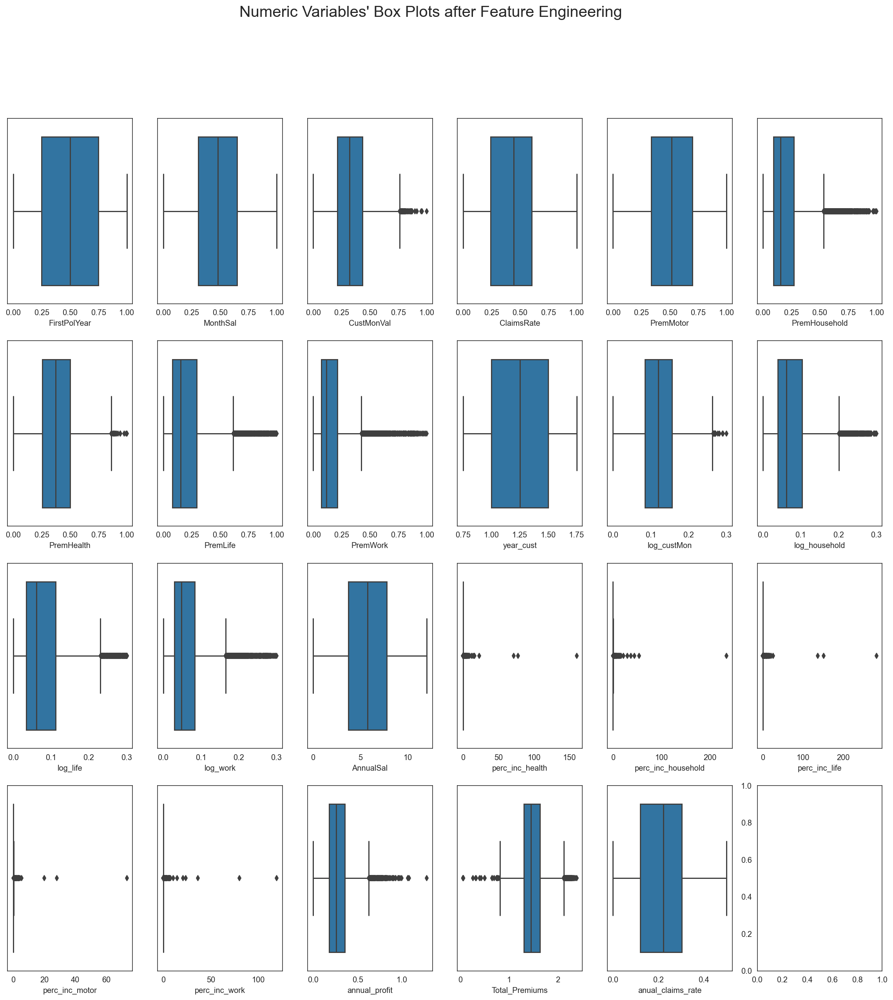

In [131]:
# All Numeric Variables' Box Plots in one figure


# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(4, ceil(len(new_metric_feat) / 4), figsize=(20, 20))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), new_metric_feat): # Notice the zip() function and flatten() method
    sns.boxplot(x=data_out_miss[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Numeric Variables' Box Plots after Feature Engineering"

plt.suptitle(title,fontsize=20)

plt.show()

In [132]:
filters_perc = (
    
    ((data_out_miss['annual_profit']<=1)|(data_out_miss['annual_profit'].isnull()))&
    ((data_out_miss['perc_inc_household']<=100)|(data_out_miss['perc_inc_household'].isnull()))&
    ((data_out_miss['perc_inc_life']<=100)|(data_out_miss['perc_inc_life'].isnull()))&
    ((data_out_miss['perc_inc_motor']<=40)|(data_out_miss['perc_inc_motor'].isnull()))&
    ((data_out_miss['perc_inc_work']<=50)|(data_out_miss['perc_inc_work'].isnull()))

)
outliers = outliers.append(data_out_miss[~filters_perc])
data_out_miss=data_out_miss[filters_perc]

In [133]:
outliers

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,...,log_work,AnnualSal,perc_inc_health,perc_inc_household,perc_inc_life,perc_inc_motor,perc_inc_work,annual_profit,Total_Premiums,anual_claims_rate
CustID,,,,,,,,,,,,,,,,,,,,,
14.0,0.375000,0.155327,1,3,1,0.178472,0.654321,0.072947,0.318241,0.291705,...,0.128033,1.863925,0.156500,0.170737,0.714765,0.039136,0.183949,0.129798,2.358026,0.327160
45.0,0.458333,0.160140,3,1,1,0.149589,0.734568,0.188571,0.030465,0.472773,...,0.072285,1.921680,0.246021,0.015853,0.584275,0.098128,0.094238,0.115811,1.995694,0.367284
52.0,0.333333,0.634653,3,4,1,-7.715917,15.654321,0.952386,0.072353,0.071173,...,0.004176,7.615839,0.009345,0.009500,0.007635,0.125053,0.001269,-5.446529,1.163722,7.827161
109.0,0.708333,0.094290,1,4,1,0.257400,0.574074,0.133518,0.752437,0.223273,...,0.038215,1.131481,0.197329,0.665002,0.942340,0.118003,0.081292,0.247104,2.267450,0.287037
113.0,0.958333,0.442135,4,1,1,-4.482956,9.660494,0.885335,0.060510,0.130368,...,0.030891,5.305622,0.024572,0.011405,0.009946,0.166867,0.013895,-5.662682,1.202703,4.830247
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2261.0,0.250000,0.000438,1,1,1,0.327338,0.413580,0.384187,0.157007,0.406342,...,0.031906,0.005250,77.391221,29.903263,136.921060,73.171596,14.518998,0.218226,1.742671,0.206790
4820.0,0.958333,0.209582,3,1,1,0.844123,0.067901,0.175614,0.763024,0.333416,...,0.106926,2.514986,0.132572,0.303391,0.164657,0.069827,0.111000,1.066261,1.965326,0.033951
6847.0,0.291667,0.000219,2,2,0,0.742772,0.098765,0.052568,0.614890,0.419579,...,0.118322,0.002625,159.824578,234.221677,282.868055,20.023850,119.292547,0.509330,2.142806,0.049383


In [134]:
# percentage of outliers to consistent dataset
#(1-(len(data_out_rmv)))/len(data_consist)*100
print('Percentage of outliers removed:', np.round((len(data_treat)-len(data_out_miss))/len(data_treat)*100,4))


Percentage of outliers removed: 2.604


In [135]:
outliers.shape

(247, 26)

In [136]:
# Use MinMaxScaler to scale the data

scaler2 = MinMaxScaler()
scaler2.fit(data_out_miss[new_metric_feat])
data_out_miss[new_metric_feat] = pd.DataFrame(scaler2.transform(data_out_miss[new_metric_feat]), columns = new_metric_feat).set_index(data_out_miss[new_metric_feat].index)
outliers[new_metric_feat] = pd.DataFrame(scaler2.transform(outliers[new_metric_feat]), columns = new_metric_feat).set_index(outliers[new_metric_feat].index)

In [137]:
data_out_miss.describe().T

,count,mean,std,min,25%,50%,75%,max
FirstPolYear,10024.0,0.500981,0.275093,0.0,0.250000,0.500000,0.750000,1.0
MonthSal,10024.0,0.479037,0.212125,0.0,0.309998,0.479982,0.648655,1.0
EducDeg_ord,10024.0,2.504090,0.782544,1.0,2.000000,3.000000,3.000000,4.0
GeoLivArea,10024.0,2.708599,1.266449,1.0,1.000000,3.000000,4.000000,4.0
Children,10024.0,0.709198,0.454155,0.0,0.000000,1.000000,1.000000,1.0
CustMonVal,10024.0,0.334486,0.133162,0.0,0.214010,0.319427,0.433253,1.0
ClaimsRate,10024.0,0.419945,0.195797,0.0,0.240741,0.444444,0.604938,1.0
PremMotor,10024.0,0.513620,0.232682,0.0,0.337138,0.516951,0.698855,1.0
PremHousehold,10024.0,0.206609,0.164391,0.0,0.094364,0.155293,0.270411,1.0
PremHealth,10024.0,0.382940,0.168414,0.0,0.256242,0.372879,0.499000,1.0


In [138]:
data_selection=data_out_miss.copy()
data_selection

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,...,log_work,AnnualSal,perc_inc_health,perc_inc_household,perc_inc_life,perc_inc_motor,perc_inc_work,annual_profit,Total_Premiums,anual_claims_rate
CustID,,,,,,,,,,,,,,,,,,,,,
22.0,0.125000,0.591337,2,3,1,0.279041,0.493827,0.695427,0.142193,0.229768,...,0.184421,0.591337,0.001412,0.000455,0.000861,0.018184,0.000528,0.172345,0.557997,0.493827
69.0,0.375000,0.233209,2,4,1,0.476027,0.203704,0.563811,0.199315,0.479268,...,0.123625,0.233209,0.007470,0.001617,0.000000,0.037381,0.000879,0.347466,0.547117,0.203704
139.0,0.208333,0.482389,2,2,1,0.299652,0.425926,0.329905,0.289871,0.000000,...,0.131663,0.482389,0.000000,0.001137,0.001478,0.010575,0.000454,0.195079,0.374719,0.425926
144.0,0.916667,0.141107,3,4,1,0.196090,0.629630,0.247806,0.326695,0.499247,...,0.231365,0.141107,0.012860,0.004380,0.014677,0.027154,0.002825,0.236168,0.778864,0.629630
185.0,0.791667,0.456355,2,4,1,0.185423,0.660494,0.000000,0.250533,0.522979,...,0.235752,0.456355,0.004165,0.001039,0.000454,0.000000,0.000891,0.194192,0.410473,0.660494
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8019.0,0.333333,0.517611,3,2,1,0.453383,0.098765,0.870287,0.037662,0.168079,...,0.023047,0.517611,0.001180,0.000138,0.000183,0.025997,0.000071,0.321204,0.456474,0.098765
8375.0,0.791667,0.129293,1,2,1,0.086359,0.740741,0.096377,0.523915,0.432816,...,0.682132,0.129293,0.012167,0.007666,0.006495,0.011526,0.010715,0.090443,0.795555,0.740741
8420.0,0.083333,0.558084,3,2,1,0.506469,0.049383,0.903812,0.076161,0.117131,...,0.076902,0.558084,0.000763,0.000258,0.000173,0.025041,0.000225,0.304991,0.482337,0.049383



<a class="anchor" id="feat-selection">

### 2.6 Feature Selection
    
</a>


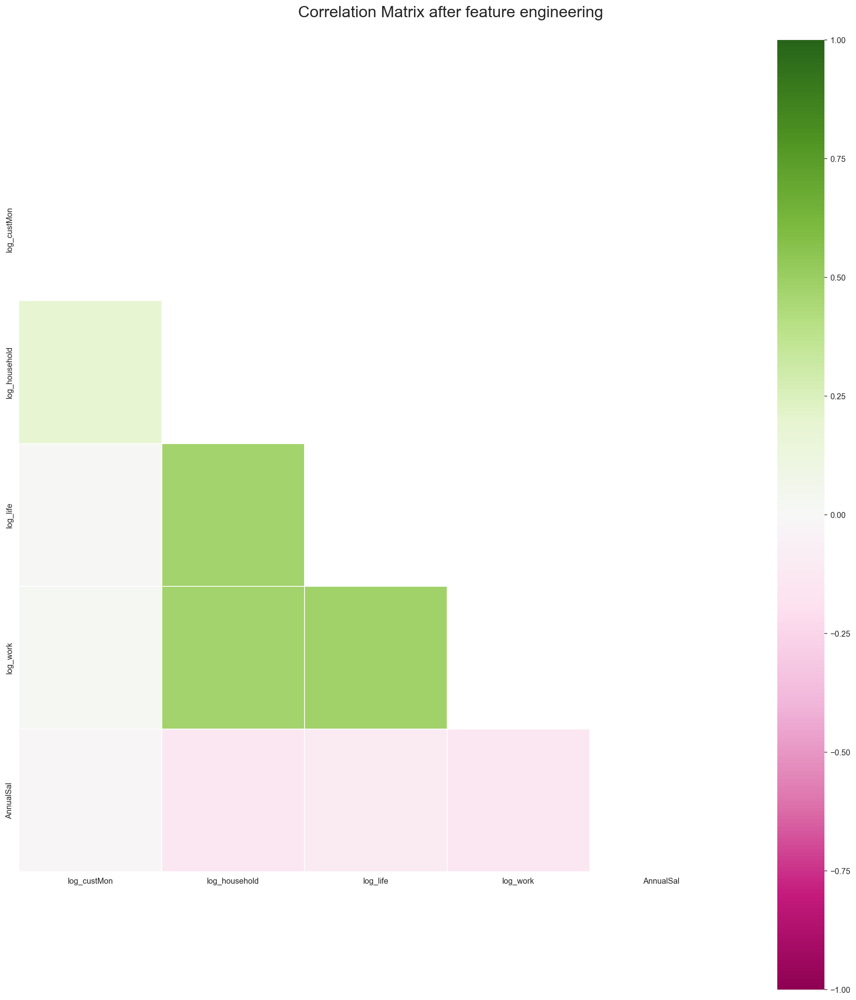

In [168]:
fig = plt.figure(figsize=(20, 20))

corr = np.round(data_selection[new_metric_feat].corr(method="spearman"), decimals=2)

mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

matrix = np.triu(corr)

sns.heatmap(data=corr, annot=annot, mask=matrix, cmap='PiYG', 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix after feature engineering", fontsize=20)

plt.show()

### Correlation between binary and continuous variables

In [140]:
data_corr = data_selection.copy()

In [141]:
data_corr.columns

Index(['FirstPolYear', 'MonthSal', 'EducDeg_ord', 'GeoLivArea', 'Children',
       'CustMonVal', 'ClaimsRate', 'PremMotor', 'PremHousehold', 'PremHealth',
       'PremLife', 'PremWork', 'year_cust', 'log_custMon', 'log_household',
       'log_life', 'log_work', 'AnnualSal', 'perc_inc_health',
       'perc_inc_household', 'perc_inc_life', 'perc_inc_motor',
       'perc_inc_work', 'annual_profit', 'Total_Premiums',
       'anual_claims_rate'],
      dtype='object')

In [142]:
def TestIndependence(X,y,var,alpha=0.05):        
    dfObserved = pd.crosstab(y,X) 
    chi2, p, dof, expected = stats.chi2_contingency(dfObserved.values)
    dfExpected = pd.DataFrame(expected, columns=dfObserved.columns, index = dfObserved.index)
    if p<alpha:
        result="{0} have some degree of dependence".format(var)
    else:
        result="{0} independent".format(var)
    print(result)

In [143]:
for var in data_corr[['GeoLivArea','EducDeg_ord']].columns.to_list():
    TestIndependence(data_corr[['GeoLivArea','EducDeg_ord']][var].squeeze(),data_corr['Children'].squeeze(), var)

GeoLivArea independent
EducDeg_ord independent


In [144]:
new_metric_feat=['log_custMon', 'log_household', 'log_life', 'log_work', 'AnnualSal']

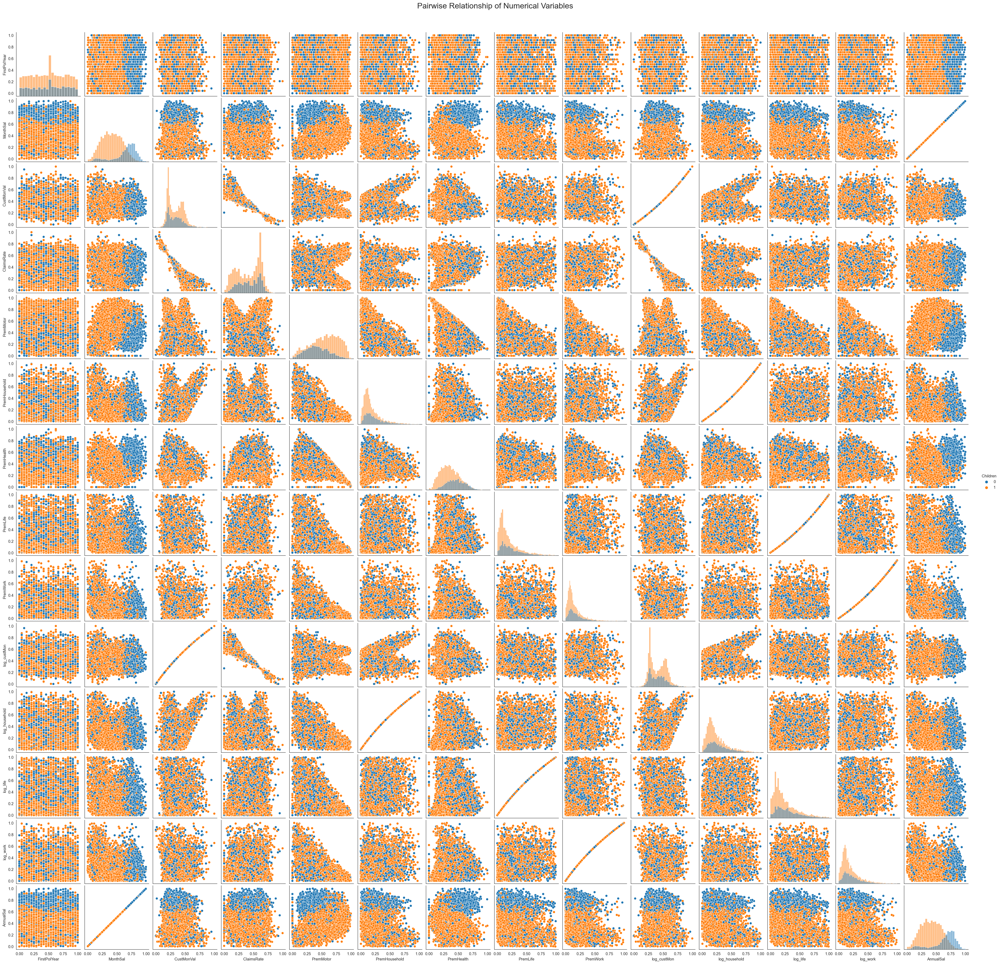

In [174]:
sns.pairplot(data_corr[metric_features+new_metric_feat + ['Children']], diag_kind="hist", hue='Children')

plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

In [146]:
def bar_charts_categorical(df, feature, target):
    cont_tab = pd.crosstab(df[feature], df[target], margins = True)
    categories = cont_tab.index[:-1]
        
    fig = plt.figure(figsize=(15, 5))
    
    plt.subplot(121)
    p1 = plt.bar(categories, cont_tab.iloc[:-1, 0].values, 0.55, color="gray")
    p2 = plt.bar(categories, cont_tab.iloc[:-1, 1].values, 0.55, bottom=cont_tab.iloc[:-1, 0], color="darkseagreen")
    plt.legend((p2[0], p1[0]), ('$y_i=1$', '$y_i=0$'))
    plt.title("Frequency bar chart")
    plt.xlabel(feature)
    plt.ylabel("$Frequency$")

    obs_pct = np.array([np.divide(cont_tab.iloc[:-1, 0].values, cont_tab.iloc[:-1, 2].values), 
                        np.divide(cont_tab.iloc[:-1, 1].values, cont_tab.iloc[:-1, 2].values)])
      
    plt.subplot(122)
    p1 = plt.bar(categories, obs_pct[0], 0.55, color="gray")
    p2 = plt.bar(categories, obs_pct[1], 0.55, bottom=obs_pct[0], color="darkseagreen")
    plt.legend((p2[0], p1[0]), ('$y_i=1$', '$y_i=0$'))
    plt.title("Proportion bar chart")
    plt.xlabel(feature)
    plt.ylabel("$p$")

    plt.show()

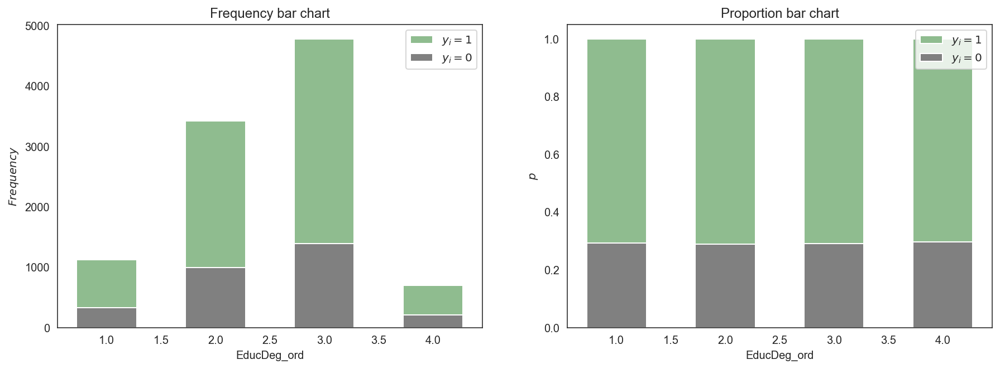

In [147]:
bar_charts_categorical(data_corr, "EducDeg_ord","Children")

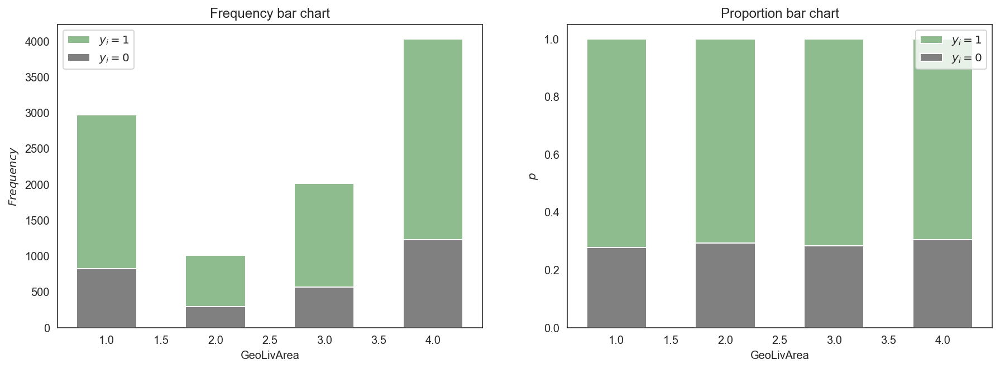

In [148]:
bar_charts_categorical(data_corr, "GeoLivArea", "Children")


<a class="anchor" id="prototypes">

## 3.1 K-prototypes
    
</a>

In [149]:
data_corr.columns

Index(['FirstPolYear', 'MonthSal', 'EducDeg_ord', 'GeoLivArea', 'Children',
       'CustMonVal', 'ClaimsRate', 'PremMotor', 'PremHousehold', 'PremHealth',
       'PremLife', 'PremWork', 'year_cust', 'log_custMon', 'log_household',
       'log_life', 'log_work', 'AnnualSal', 'perc_inc_health',
       'perc_inc_household', 'perc_inc_life', 'perc_inc_motor',
       'perc_inc_work', 'annual_profit', 'Total_Premiums',
       'anual_claims_rate'],
      dtype='object')

In [150]:
data_prot=data_corr[['Children', 'EducDeg_ord', 'MonthSal']]
categorical_columns = [0, 1]

In [224]:
cost_elbow = []
for n_clus in range(1,11):  # iterate over desired ncluster range
    kproto = KPrototypes(n_clusters= n_clus, init='Huang',n_jobs = 1)
    clusters = kproto.fit_predict(data_prot, categorical=categorical_columns)
    cost_elbow.append(kproto.cost_)  # save the inertia of the given cluster solution

In [225]:
cost_elbow

[1316.21658658477,
 865.2739016879937,
 580.9809187051587,
 485.22291421914235,
 391.1823989912207,
 317.43936064263045,
 290.06278317422107,
 245.2827875214365,
 220.23364159692767,
 176.26337706402845]

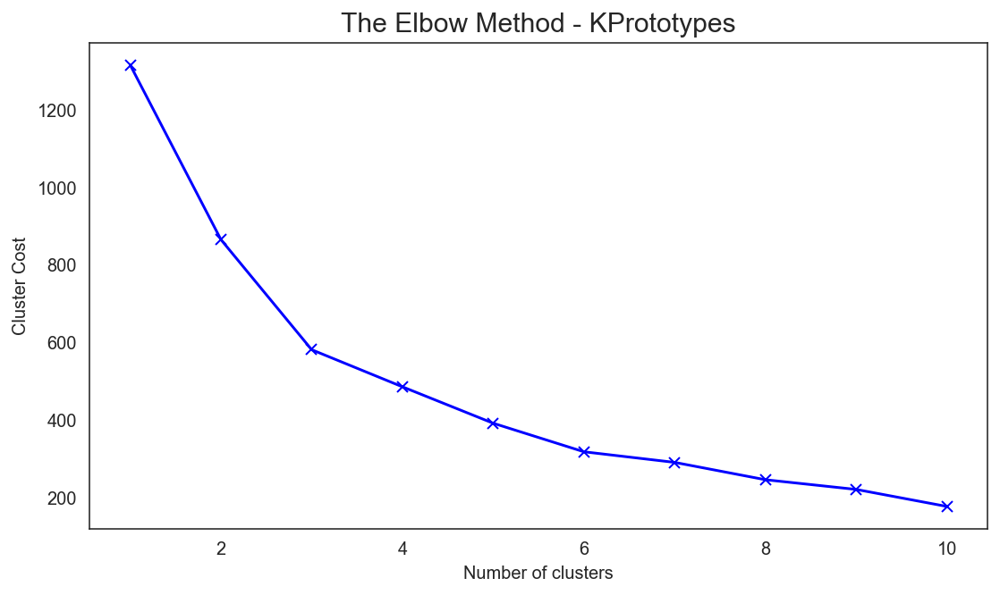

In [226]:
sns.set_style("white")
range_K=range(1,11)
plt.figure(figsize=(9,5))
plt.plot(range_K, cost_elbow, 'bx-')
pd.Series(cost_elbow,index=range_K)
plt.xlabel('Number of clusters')
plt.ylabel('Cluster Cost')
plt.title('The Elbow Method - KPrototypes', size=15)
#plt.savefig(os.path.join('..\DataMining_project_master.git/figures', 'prototype_elbow'), dpi=200)
plt.show()


In [151]:
kproto_3 = KPrototypes(n_clusters= 3, init='Huang', n_jobs = 1, random_state=42)
clusters_3 = kproto_3.fit_predict(data_prot, categorical=categorical_columns)

pd.Series(clusters_3).value_counts()

2    4011
0    3478
1    2535
dtype: int64

In [152]:
clusters_3_df=pd.DataFrame(clusters_3+1,index=data_prot.index).rename(columns={0:'social_labels'})

In [153]:
clusters_3_df

,social_labels
CustID,
22.0,1
69.0,1
139.0,1
144.0,3
185.0,1
...,...
8019.0,3
8375.0,1
8420.0,3


In [196]:
social_labels = pd.concat([data_prot, clusters_3_df], axis=1)
social_labels=social_labels.merge(data_ohc[['GeoLivArea_1','GeoLivArea_2','GeoLivArea_3','GeoLivArea_4']],on='CustID',how='left')
social_labels.groupby('social_labels').mean()

,Children,EducDeg_ord,MonthSal,GeoLivArea_1,GeoLivArea_2,GeoLivArea_3,GeoLivArea_4
social_labels,,,,,,,
1,0.895055,1.951409,0.354155,0.296722,0.098332,0.199827,0.405118
2,0.047337,2.595266,0.721822,0.283235,0.103353,0.192899,0.420513
3,0.966343,2.925704,0.433882,0.304662,0.100723,0.206682,0.387933


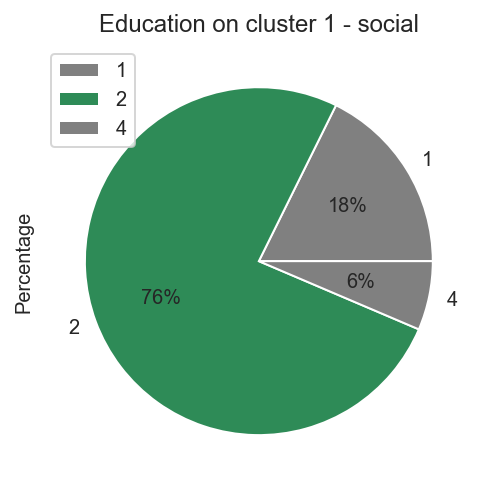

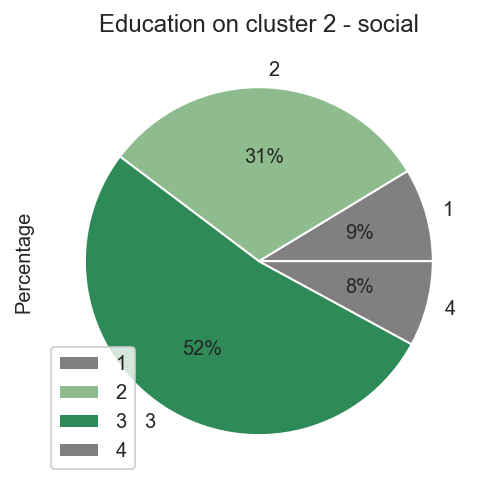

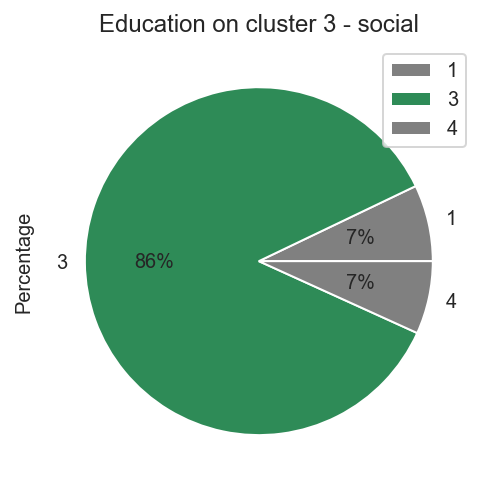

In [160]:
label1 = social_labels[social_labels['social_labels']==1].groupby(['EducDeg_ord']).count().rename(columns={'Children':'Percentage'}).plot(kind='pie', autopct='%1.0f%%',
                                colors = ['gray', 'seagreen', 'gray'],
                                title='Education on cluster 1 - social', y = 'Percentage')


label2 = social_labels[social_labels['social_labels']==2].groupby(['EducDeg_ord']).count().rename(columns={'Children':'Percentage'}).plot(kind='pie', autopct='%1.0f%%',
                                colors = ['gray', 'darkseagreen', 'seagreen'],
                                title='Education on cluster 2 - social', y = 'Percentage')

label3 = social_labels[social_labels['social_labels']==3].groupby(['EducDeg_ord']).count().rename(columns={'Children':'Percentage'}).plot(kind='pie', autopct='%1.0f%%',
                                colors = ['gray', 'seagreen', 'gray'],
                                title='Education on cluster 3 - social', y = 'Percentage')



<a class="anchor" id="medoids">

## 3.2 K-medoids and Hierarquical Clustering
    
</a>

In [160]:
data_product = data_corr[['log_household', 'PremHealth', 'log_life', 'log_work', 'annual_profit']]
inertia = []
for i in range(1, 15):
    kmedoids =  KMedoids(n_clusters=i, init='k-medoids++', random_state=42).fit(data_product)
    inertia.append(kmedoids.inertia_)
inertia

[3536.1385131544403,
 2927.0086540974894,
 2640.6671699345425,
 2519.4467061713676,
 2416.5454825093557,
 2322.5698461583697,
 2261.8727129987456,
 2271.0708502086127,
 2202.7864196643804,
 2167.5391243695058,
 2072.693678044877,
 2031.4578740277611,
 2008.3281979701007,
 1998.9451413736444]

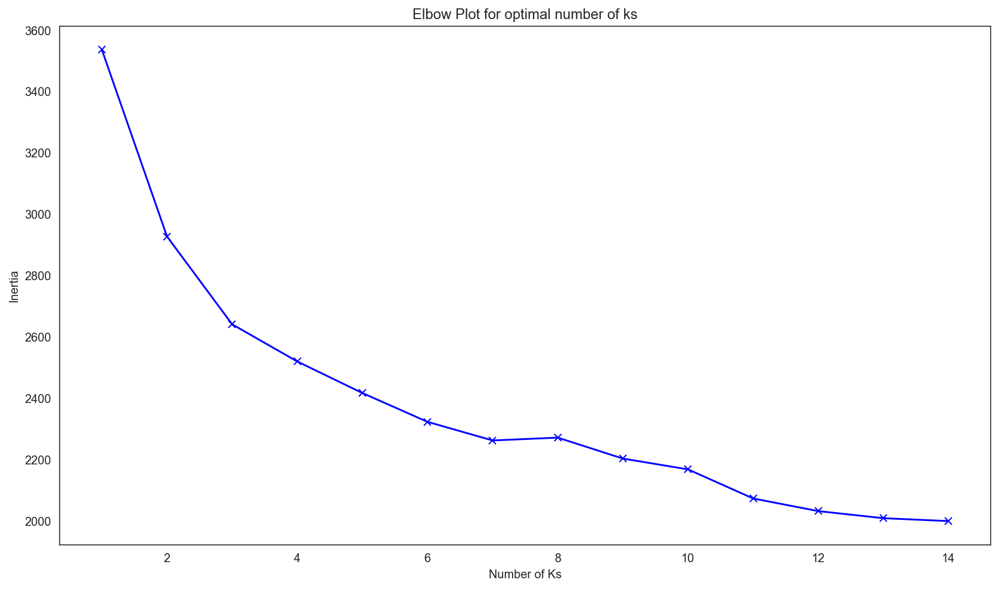

In [161]:
plt.figure(figsize=(14,8))
plt.plot(range(1, 15), inertia, 'bx-')
plt.xlabel('Number of Ks')
plt.ylabel('Inertia')
plt.title('Elbow Plot for optimal number of ks')
plt.show()

We're going to start by running K-medoids clustering with a lot of clusters and then use the centroids to compute the Hierarquical Clustering

In [197]:
data_product = data_corr[['log_household', 'PremHealth', 'log_life', 'log_work', 'annual_profit']]
data_product

,log_household,PremHealth,log_life,log_work,annual_profit
CustID,,,,,
22.0,0.191807,0.229768,0.205971,0.184421,0.172345
69.0,0.262210,0.479268,0.000000,0.123625,0.347466
139.0,0.367226,0.000000,0.280786,0.131663,0.195079
144.0,0.407836,0.499247,0.699660,0.231365,0.236168
185.0,0.322543,0.522979,0.087409,0.235752,0.194192
...,...,...,...,...,...
8019.0,0.053336,0.168079,0.040599,0.023047,0.321204
8375.0,0.607782,0.432816,0.325489,0.682132,0.090443
8420.0,0.105895,0.117131,0.041347,0.076902,0.304991


In [198]:
k_means_eco = KMedoids(n_clusters=50, init='k-medoids++', random_state=42)
k_means_eco.fit(data_product)

KMedoids(init='k-medoids++', n_clusters=50, random_state=42)

In [199]:
labels_product = k_means_eco.predict(data_product)
labels_product

array([46, 31, 37, ..., 22, 31,  3], dtype=int64)

In [200]:
concat_df = pd.concat((data_product, pd.DataFrame(labels_product,index = data_product.index).rename(columns = {0:'Cluster Labels'})), axis = 1)
concat_df

,log_household,PremHealth,log_life,log_work,annual_profit,Cluster Labels
CustID,,,,,,
22.0,0.191807,0.229768,0.205971,0.184421,0.172345,46
69.0,0.262210,0.479268,0.000000,0.123625,0.347466,31
139.0,0.367226,0.000000,0.280786,0.131663,0.195079,37
144.0,0.407836,0.499247,0.699660,0.231365,0.236168,26
185.0,0.322543,0.522979,0.087409,0.235752,0.194192,48
...,...,...,...,...,...,...
8019.0,0.053336,0.168079,0.040599,0.023047,0.321204,22
8375.0,0.607782,0.432816,0.325489,0.682132,0.090443,30
8420.0,0.105895,0.117131,0.041347,0.076902,0.304991,22


In [201]:
k_means_grouped = concat_df.groupby(by = 'Cluster Labels').mean()
k_means_grouped

,log_household,PremHealth,log_life,log_work,annual_profit
Cluster Labels,,,,,
0,0.527407,0.557655,0.124467,0.288049,0.409965
1,0.145257,0.280582,0.128414,0.097772,0.353371
2,0.319498,0.356079,0.342881,0.146618,0.280856
3,0.174112,0.619582,0.545495,0.228341,0.224950
4,0.478911,0.350754,0.749925,0.519211,0.235210
5,0.163303,0.604095,0.284558,0.137721,0.219385
6,0.274319,0.500401,0.187943,0.223714,0.329332
7,0.532084,0.314770,0.703942,0.183531,0.525734
8,0.398365,0.270192,0.435774,0.350097,0.382767


#### Hierarquical Clustering

In [202]:
def get_r2_hc(df, link_method, max_nclus, min_nclus=1, dist="euclidean"):
    """This function computes the R2 for a set of cluster solutions given by the application of a hierarchical method.
    The R2 is a measure of the homogenity of a cluster solution. It is based on SSt = SSw + SSb and R2 = SSb/SSt. 
    
    Parameters:
    df (DataFrame): Dataset to apply clustering
    link_method (str): either "ward", "complete", "average", "single"
    max_nclus (int): maximum number of clusters to compare the methods
    min_nclus (int): minimum number of clusters to compare the methods. Defaults to 1.
    dist (str): distance to use to compute the clustering solution. Must be a valid distance. Defaults to "euclidean".
    
    Returns:
    ndarray: R2 values for the range of cluster solutions
    """
    def get_ss(df):
        ss = np.sum(df.var() * (df.count() - 1))
        return ss  # return sum of sum of squares of each df variable
    
    sst = get_ss(df)  # get total sum of squares
    
    r2 = []  # where we will store the R2 metrics for each cluster solution
    
    for i in range(min_nclus, max_nclus+1):  # iterate over desired ncluster range
        cluster = AgglomerativeClustering(n_clusters=i, affinity=dist, linkage=link_method)
        hclabels = cluster.fit_predict(df) #get cluster labels
        df_concat = pd.concat((df, pd.Series(hclabels, name='labels')), axis=1)  # concat df with labels
        ssw_labels = df_concat.groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
        ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
        r2.append(ssb / sst)  # save the R2 of the given cluster solution
        
    return np.array(r2)

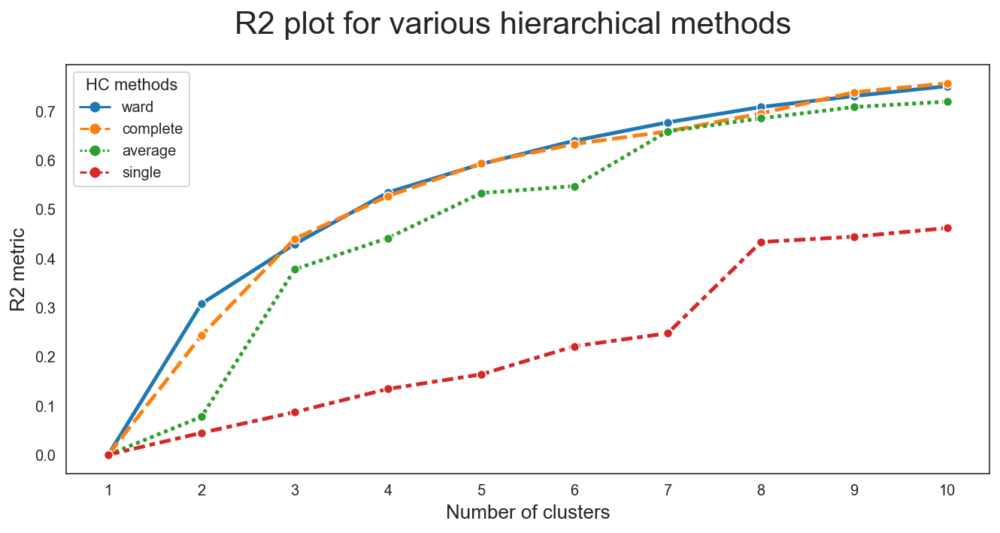

In [203]:
# Prepare input
hc_methods = ["ward", "complete", "average", "single"]
# Call function defined above to obtain the R2 statistic for each hc_method
max_nclus = 10
r2_hc_methods = np.vstack(
    [
        get_r2_hc(df=k_means_grouped, link_method=link, max_nclus=max_nclus) 
        for link in hc_methods
    ]
).T

r2_hc_methods = pd.DataFrame(r2_hc_methods, index=range(1, max_nclus + 1), columns=hc_methods)


# Plot data
fig = plt.figure(figsize=(11,5))
sns.lineplot(data=r2_hc_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=21)
plt.gca()#.invert_xaxis()  # invert x axis
plt.legend(title="HC methods", title_fontsize=11)
plt.xticks(range(1, max_nclus + 1))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)
#plt.savefig(os.path.join('..\DataMining_project_master.git/figures', 'hierarquical_elbow'), dpi=200)
plt.show()

In [204]:
r2_hc_methods

,ward,complete,average,single
1,0.000000,0.000000,0.000000,0.000000
2,0.307937,0.243313,0.077433,0.044690
3,0.429550,0.440325,0.377943,0.086921
4,0.534714,0.527090,0.441808,0.134185
5,0.592519,0.593909,0.533370,0.163746
6,0.639934,0.633278,0.547462,0.221152
7,0.677441,0.659062,0.659234,0.247575
8,0.708739,0.695650,0.685637,0.433534
9,0.731096,0.738810,0.708677,0.444452
10,0.751288,0.757181,0.719711,0.462042


In [205]:
linkage = 'ward'
distance = 'euclidean'
hclust = AgglomerativeClustering(linkage=linkage, affinity=distance, distance_threshold=0, n_clusters=None)
hclust.fit_predict(k_means_grouped)

array([29, 47, 38, 34, 39, 44, 46, 36, 32, 48, 31, 35, 28, 27, 37, 33, 40,
       15, 43, 18, 13, 49, 16, 41, 19, 26, 30, 42, 17,  8, 25,  7, 12, 14,
       20, 23, 24, 45, 11,  5, 21, 22,  9, 10,  3,  6,  4,  1,  2,  0],
      dtype=int64)

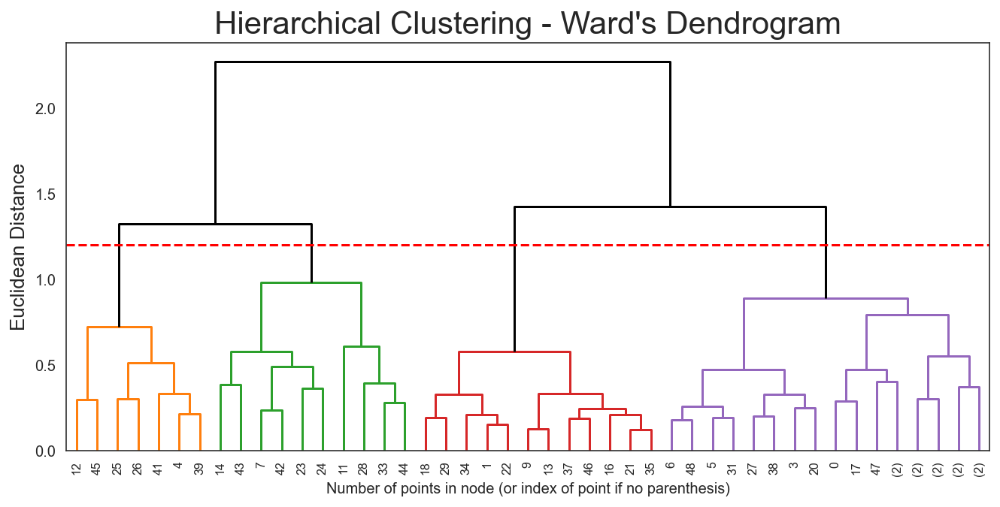

In [206]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 1.2
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'{distance.title()} Distance', fontsize=13)
#plt.savefig(os.path.join('..\DataMining_project_master.git/figures', 'dendogram_hierarquical'), dpi=200)
plt.show()

In [207]:
linkage = 'ward'
distance = 'euclidean'
num_clust = 4

final_hclust = AgglomerativeClustering(affinity = distance, linkage = linkage, n_clusters = num_clust)
final_hc_labels = final_hclust.fit_predict(k_means_grouped)

final_df = pd.concat((k_means_grouped, pd.Series(final_hc_labels, name = 'product_labels')), axis = 1)
final_df.groupby('product_labels').mean()

,log_household,PremHealth,log_life,log_work,annual_profit
product_labels,,,,,
0,0.657168,0.349243,0.534461,0.355631,0.447049
1,0.332096,0.491425,0.319900,0.279322,0.270769
2,0.155157,0.284005,0.130905,0.129160,0.296183
3,0.315111,0.383638,0.715042,0.469069,0.223398


In [208]:
final_df['labels50']=final_df.index

In [209]:
final_df=final_df[['labels50','product_labels']]

In [210]:
concat_df


,log_household,PremHealth,log_life,log_work,annual_profit,Cluster Labels
CustID,,,,,,
22.0,0.191807,0.229768,0.205971,0.184421,0.172345,46
69.0,0.262210,0.479268,0.000000,0.123625,0.347466,31
139.0,0.367226,0.000000,0.280786,0.131663,0.195079,37
144.0,0.407836,0.499247,0.699660,0.231365,0.236168,26
185.0,0.322543,0.522979,0.087409,0.235752,0.194192,48
...,...,...,...,...,...,...
8019.0,0.053336,0.168079,0.040599,0.023047,0.321204,22
8375.0,0.607782,0.432816,0.325489,0.682132,0.090443,30
8420.0,0.105895,0.117131,0.041347,0.076902,0.304991,22


In [211]:
products_labels=pd.merge(concat_df,final_df, left_on='Cluster Labels',right_on='labels50',how='left').set_index(concat_df.index)

In [212]:
products_labels

,log_household,PremHealth,log_life,log_work,annual_profit,Cluster Labels,labels50,product_labels
CustID,,,,,,,,
22.0,0.191807,0.229768,0.205971,0.184421,0.172345,46,46,2
69.0,0.262210,0.479268,0.000000,0.123625,0.347466,31,31,1
139.0,0.367226,0.000000,0.280786,0.131663,0.195079,37,37,2
144.0,0.407836,0.499247,0.699660,0.231365,0.236168,26,26,3
185.0,0.322543,0.522979,0.087409,0.235752,0.194192,48,48,1
...,...,...,...,...,...,...,...,...
8019.0,0.053336,0.168079,0.040599,0.023047,0.321204,22,22,2
8375.0,0.607782,0.432816,0.325489,0.682132,0.090443,30,30,1
8420.0,0.105895,0.117131,0.041347,0.076902,0.304991,22,22,2


In [213]:
products_labels.drop(columns={'labels50','Cluster Labels'},inplace=True)

In [214]:
products_labels.groupby('product_labels').mean()

,log_household,PremHealth,log_life,log_work,annual_profit
product_labels,,,,,
0,0.640208,0.358629,0.545108,0.353136,0.443570
1,0.296229,0.499325,0.302099,0.246825,0.265611
2,0.146804,0.270305,0.128790,0.118261,0.279727
3,0.311641,0.399991,0.701849,0.450682,0.223594


In [224]:
pd.concat([products_labels,data_corr.drop(columns=products_labels.columns.to_list()[:-1]+data_prot.columns.to_list())],axis=1).groupby('product_labels').mean()

,log_household,PremHealth,log_life,log_work,annual_profit,FirstPolYear,GeoLivArea,CustMonVal,ClaimsRate,PremMotor,...,year_cust,log_custMon,AnnualSal,perc_inc_health,perc_inc_household,perc_inc_life,perc_inc_motor,perc_inc_work,Total_Premiums,anual_claims_rate
product_labels,,,,,,,,,,,,,,,,,,,,,
0,0.640208,0.358629,0.545108,0.353136,0.443570,0.587160,2.682398,0.486989,0.322854,0.213966,...,0.412840,0.559211,0.345193,0.012092,0.012314,0.015905,0.020190,0.008745,0.795296,0.322854
1,0.296229,0.499325,0.302099,0.246825,0.265611,0.487380,2.722687,0.320733,0.448079,0.393912,...,0.512620,0.396531,0.497752,0.005906,0.001576,0.002686,0.017293,0.001567,0.645169,0.448079
2,0.146804,0.270305,0.128790,0.118261,0.279727,0.501996,2.687829,0.328572,0.396934,0.724278,...,0.498004,0.403523,0.500789,0.002267,0.000466,0.000713,0.025288,0.000453,0.527068,0.396934
3,0.311641,0.399991,0.701849,0.450682,0.223594,0.477536,2.796522,0.274321,0.516436,0.219370,...,0.522464,0.344511,0.356464,0.009879,0.003392,0.015515,0.018346,0.007013,0.786353,0.516436


In [222]:
data_corr.drop(columns=products_labels.columns.to_list()[:-1])

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremLife,...,year_cust,log_custMon,AnnualSal,perc_inc_health,perc_inc_household,perc_inc_life,perc_inc_motor,perc_inc_work,Total_Premiums,anual_claims_rate
CustID,,,,,,,,,,,,,,,,,,,,,
22.0,0.125000,0.591337,2,3,1,0.279041,0.493827,0.695427,0.142193,0.153462,...,0.875000,0.355063,0.591337,0.001412,0.000455,0.000861,0.018184,0.000528,0.557997,0.493827
69.0,0.375000,0.233209,2,4,1,0.476027,0.203704,0.563811,0.199315,0.000000,...,0.625000,0.561719,0.233209,0.007470,0.001617,0.000000,0.037381,0.000879,0.547117,0.203704
139.0,0.208333,0.482389,2,2,1,0.299652,0.425926,0.329905,0.289871,0.214857,...,0.791667,0.378126,0.482389,0.000000,0.001137,0.001478,0.010575,0.000454,0.374719,0.425926
144.0,0.916667,0.141107,3,4,1,0.196090,0.629630,0.247806,0.326695,0.624122,...,0.083333,0.258326,0.141107,0.012860,0.004380,0.014677,0.027154,0.002825,0.778864,0.629630
185.0,0.791667,0.456355,2,4,1,0.185423,0.660494,0.000000,0.250533,0.062461,...,0.208333,0.245403,0.456355,0.004165,0.001039,0.000454,0.000000,0.000891,0.410473,0.660494
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8019.0,0.333333,0.517611,3,2,1,0.453383,0.098765,0.870287,0.037662,0.028541,...,0.666667,0.539415,0.517611,0.001180,0.000138,0.000183,0.025997,0.000071,0.456474,0.098765
8375.0,0.791667,0.129293,1,2,1,0.086359,0.740741,0.096377,0.523915,0.253089,...,0.208333,0.119501,0.129293,0.012167,0.007666,0.006495,0.011526,0.010715,0.795555,0.740741
8420.0,0.083333,0.558084,3,2,1,0.506469,0.049383,0.903812,0.076161,0.029074,...,0.916667,0.591171,0.558084,0.000763,0.000258,0.000173,0.025041,0.000225,0.482337,0.049383


In [215]:
products_labels.groupby('product_labels').count()

,log_household,PremHealth,log_life,log_work,annual_profit
product_labels,,,,,
0,784,784,784,784,784
1,4302,4302,4302,4302,4302
2,4363,4363,4363,4363,4363
3,575,575,575,575,575


In [228]:
kmeans_hierarquical = pd.concat([products_labels, data_selection['anual_claims_rate'], data_selection['year_cust']], axis = 1)

In [229]:
kmeans_hierarquical.groupby('product_labels').mean()

,log_household,PremHealth,log_life,log_work,annual_profit,anual_claims_rate,year_cust
product_labels,,,,,,,
0,0.640208,0.358629,0.545108,0.353136,0.443570,0.322854,0.412840
1,0.296229,0.499325,0.302099,0.246825,0.265611,0.448079,0.512620
2,0.146804,0.270305,0.128790,0.118261,0.279727,0.396934,0.498004
3,0.311641,0.399991,0.701849,0.450682,0.223594,0.516436,0.522464


In [230]:
product_features = products_labels.columns.to_list()
product_features

['log_household',
 'PremHealth',
 'log_life',
 'log_work',
 'annual_profit',
 'product_labels']

In [231]:
#Computing ssw for each cluster

vars = products_labels[product_features].groupby(by = 'product_labels').var()
counts = products_labels[product_features].groupby(by = 'product_labels').count() - 1

products = vars.mul(counts).T.sum()
products

product_labels
0    141.029819
1    417.161567
2    207.403073
3     75.267304
dtype: float64

In [232]:
sst = products_labels[product_features[:-1]].var().mul(products_labels[product_features[:-1]].count()-1).sum()

In [233]:
ssb = sst - np.sum(products)

In [234]:
r2 = ssb / sst
r2

0.4412927351646353

In [235]:
data_pers=pd.merge(products_labels,social_labels,how='left',left_on=products_labels.index, right_on=social_labels.index).rename(columns={'key_0':'CustID'}).set_index('CustID')
data_pers

,log_household,PremHealth,log_life,log_work,annual_profit,product_labels,Children,EducDeg_ord,MonthSal,social_labels,GeoLivArea_1,GeoLivArea_2,GeoLivArea_3,GeoLivArea_4
CustID,,,,,,,,,,,,,,
22.0,0.191807,0.229768,0.205971,0.184421,0.172345,2,1,2,0.591337,1,0.0,0.0,1.0,0.0
69.0,0.262210,0.479268,0.000000,0.123625,0.347466,1,1,2,0.233209,1,0.0,0.0,0.0,1.0
139.0,0.367226,0.000000,0.280786,0.131663,0.195079,2,1,2,0.482389,1,0.0,1.0,0.0,0.0
144.0,0.407836,0.499247,0.699660,0.231365,0.236168,3,1,3,0.141107,3,0.0,0.0,0.0,1.0
185.0,0.322543,0.522979,0.087409,0.235752,0.194192,1,1,2,0.456355,1,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8019.0,0.053336,0.168079,0.040599,0.023047,0.321204,2,1,3,0.517611,3,0.0,1.0,0.0,0.0
8375.0,0.607782,0.432816,0.325489,0.682132,0.090443,1,1,1,0.129293,1,0.0,1.0,0.0,0.0
8420.0,0.105895,0.117131,0.041347,0.076902,0.304991,2,1,3,0.558084,3,0.0,1.0,0.0,0.0



<a class="anchor" id="SOM">

## 3.2 SOM
    
</a>

In [246]:
np.random.seed(42)

sm = sompy.SOMFacory().build(
    data_product.values, 
    mapsize=[10, 10],
    initialization='random', 
    neighborhood='gaussian',
    training='batch',
    lattice='hexa',
    component_names=metric_features
)
sm.train(n_job=4, verbose='info', train_rough_len=100, train_finetune_len=100)

AttributeError: module 'sompy' has no attribute 'SOMFacory'

In [ ]:
# Perform Hierarchical clustering on top of the 2500 untis (sm.get_node_vectors() output)
hierclust = AgglomerativeClustering(n_clusters=4, linkage='ward')
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
sm.cluster_labels = nodeclus_labels  # setting the cluster labels of sompy

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(sm, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

In [ ]:
#Computing ssw for each cluster

vars = products_labels[product_features].groupby(by = 'product_labels').var()
counts = products_labels[product_features].groupby(by = 'product_labels').count() - 1

products = vars.mul(counts).T.sum()
products

product_labels
0    141.029819
1    417.161567
2    207.403073
3     75.267304
dtype: float64

In [ ]:
sst = products_labels[product_features[:-1]].var().mul(products_labels[product_features[:-1]].count()-1).sum()

In [ ]:
ssb = sst - np.sum(products)

In [ ]:
r2 = ssb / sst
r2

0.4412927351646353

<a class="anchor" id="merging_perspectives">

## 3.3 Merging Perspectives
    
</a>

In [295]:
# Applying the right clustering (algorithm and number of clusters) for each perspective

data_pers.groupby(['product_labels', 'social_labels'])\
                    .size()\
                    .to_frame()\
                    .reset_index()\
                    .pivot( 'product_labels','social_labels', 0)

social_labels,1,2,3
product_labels,,,
0,507,150,127
1,1481,1533,1288
2,1126,735,2502
3,364,117,94


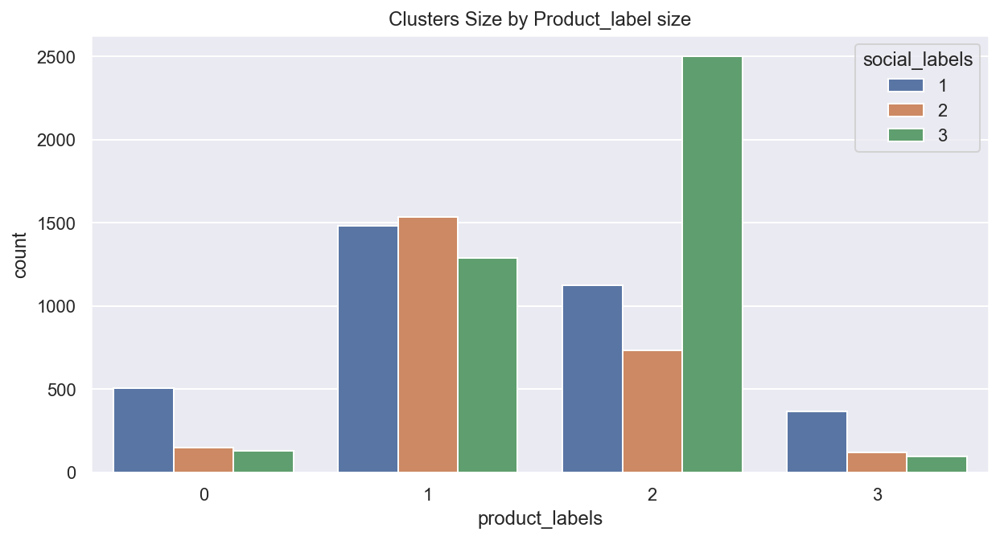

In [296]:
plt.figure(figsize = (10,5))
sns.countplot(data = data_pers, x = 'product_labels', hue = 'social_labels')
plt.title('Clusters Size by Product_label size')
plt.show()

In [297]:
# Clusters with low frequency to be merged:
to_merge = [(3,3), (3,2), (0,2), (0,3)]

df_centroids = data_pers.groupby(['product_labels', 'social_labels'])\
    [['log_household', 'PremHealth', 'log_life', 'log_work', 'annual_profit',
        'MonthSal']].mean()

# Computing the euclidean distance matrix between the centroids
euclidean = pairwise_distances(df_centroids)
df_dists = pd.DataFrame(
    euclidean, columns=df_centroids.index, index=df_centroids.index
)

# Merging each low frequency clustering (source) to the closest cluster (target)
source_target = {}
for clus in to_merge:
    if clus not in source_target.values():
        source_target[clus] = df_dists.loc[clus].sort_values().index[1]

source_target

{(3, 3): (3, 1), (3, 2): (3, 3), (0, 2): (0, 3)}

In [298]:
cluster_changes={
                (0, 1): 1,
                (0, 2): 3,
                (0, 3): 3,
                (1, 1): 4,
                (1, 2): 5,
                (1, 3): 6,
                (2, 1): 7,
                (2, 2): 8,
                (2, 3): 9,
                (3, 1): 10,
                (3, 2): 12,
                (3, 3): 10
                }

In [299]:
df_ = data_pers.copy()

# Changing the behavior_labels and product_labels based on source_target
for source, target in source_target.items():
    mask = (df_['product_labels']==source[0]) & (df_['social_labels']==source[1])
    df_.loc[mask, 'product_labels'] = target[0]
    df_.loc[mask, 'social_labels'] = target[1]

# New contigency table
df_.groupby(['product_labels', 'social_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot( 'product_labels', 'social_labels',0)

social_labels,1,2,3
product_labels,,,
0,507.0,NaN,277.0
1,1481.0,1533.0,1288.0
2,1126.0,735.0,2502.0
3,458.0,NaN,117.0


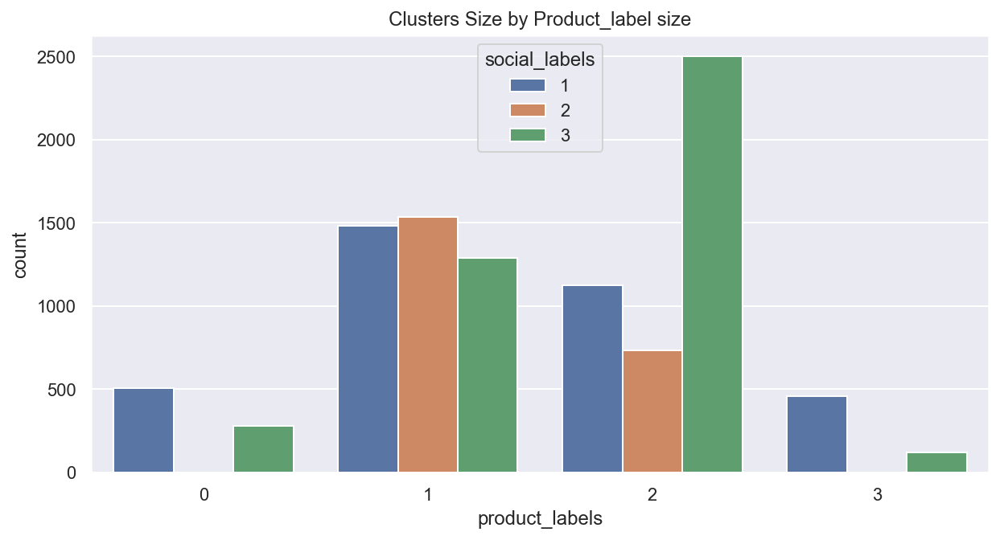

In [300]:
plt.figure(figsize = (10,5))
sns.countplot(data = df_, x = 'product_labels', hue = 'social_labels')
plt.title('Clusters Size by Product_label size')
plt.show()

In [301]:
# Clusters with low frequency to be merged:
to_merge = [(0,3), (3,3)]

df_centroids = data_pers.groupby(['product_labels', 'social_labels'])\
    [['log_household', 'PremHealth', 'log_life', 'log_work', 'annual_profit',
        'MonthSal']].mean()

# Computing the euclidean distance matrix between the centroids
euclidean = pairwise_distances(df_centroids)
df_dists = pd.DataFrame(
    euclidean, columns=df_centroids.index, index=df_centroids.index
)

# Merging each low frequency clustering (source) to the closest cluster (target)
source_target = {}
for clus in to_merge:
    if clus not in source_target.values():
        source_target[clus] = df_dists.loc[clus].sort_values().index[1]

source_target

{(0, 3): (0, 1), (3, 3): (3, 1)}

In [302]:
cluster_changes={
                (0, 1): 1,
                (0, 2): 1,
                (0, 3): 1,
                (1, 1): 4,
                (1, 2): 5,
                (1, 3): 6,
                (2, 1): 7,
                (2, 2): 8,
                (2, 3): 9,
                (3, 1): 10,
                (3, 2): 10,
                (3, 3): 10
                }

In [303]:
# Changing the behavior_labels and product_labels based on source_target
for source, target in source_target.items():
    mask = (df_['product_labels']==source[0]) & (df_['social_labels']==source[1])
    df_.loc[mask, 'product_labels'] = target[0]
    df_.loc[mask, 'social_labels'] = target[1]

# New contigency table
df_.groupby(['product_labels', 'social_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot( 'product_labels', 'social_labels',0)

social_labels,1,2,3
product_labels,,,
0,784.0,NaN,NaN
1,1481.0,1533.0,1288.0
2,1126.0,735.0,2502.0
3,575.0,NaN,NaN


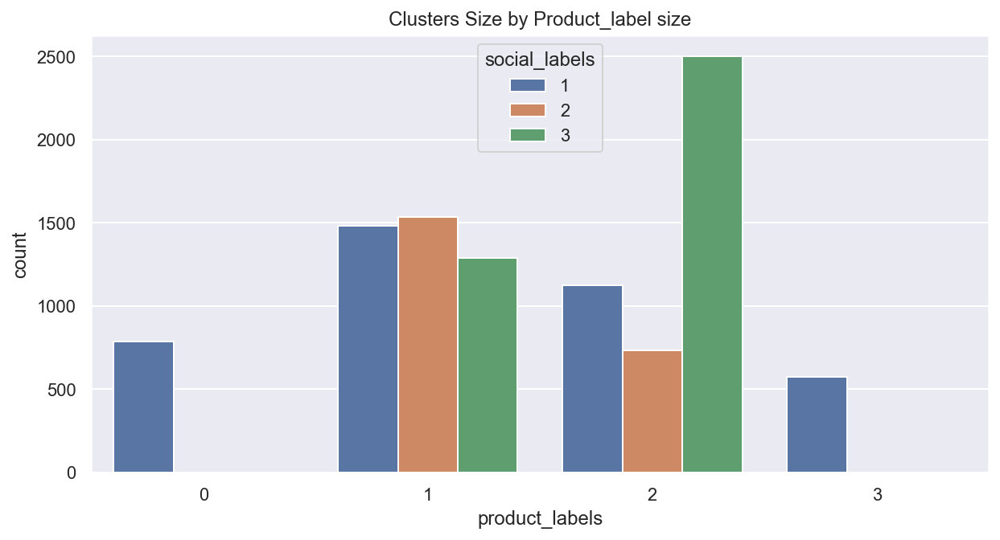

In [304]:
plt.figure(figsize = (10,5))
sns.countplot(data = df_, x = 'product_labels', hue = 'social_labels')
plt.title('Clusters Size by Product_label size')
plt.show()

In [305]:
cluster_changes={
                (0, 1): 1,
                (0, 2): 1,
                (0, 3): 1,
                (1, 1): 4,
                (1, 2): 5,
                (1, 3): 6,
                (2, 1): 7,
                (2, 2): 8,
                (2, 3): 9,
                (3, 1): 10,
                (3, 2): 10,
                (3, 3): 10
                }

In [306]:
# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_changes[
        (row['product_labels'], row['social_labels'])
    ], axis=1
)

# Merged cluster centroids
df_.groupby('merged_labels').mean()

,log_household,PremHealth,log_life,log_work,annual_profit,product_labels,Children,EducDeg_ord,MonthSal,social_labels
merged_labels,,,,,,,,,,
1,0.640208,0.358629,0.545108,0.353136,0.443570,0.0,0.639031,1.817602,0.345193,1.0
4,0.324777,0.476805,0.325040,0.282000,0.264819,1.0,0.910871,1.948008,0.354472,1.0
5,0.282656,0.534240,0.293194,0.231930,0.264004,1.0,0.024788,2.513372,0.732219,2.0
6,0.279558,0.483661,0.286319,0.224105,0.268436,1.0,0.944876,2.83618,0.383434,3.0
7,0.157413,0.267346,0.140965,0.130261,0.276644,2.0,0.961812,2.241563,0.443645,1.0
8,0.157867,0.323152,0.142662,0.127763,0.279232,2.0,0.102041,2.983673,0.700394,2.0
9,0.138779,0.256112,0.119235,0.110070,0.281260,2.0,0.989209,3.002398,0.467869,3.0
10,0.311641,0.399991,0.701849,0.450682,0.223594,3.0,0.645217,1.836522,0.356464,1.0


### Merging more since centroids are very similar

In [307]:
# Clusters with low frequency to be merged:
to_merge = [(1,3), (2,1)]

df_centroids = data_pers.groupby(['product_labels', 'social_labels'])\
    [['log_household', 'PremHealth', 'log_life', 'log_work', 'annual_profit',
        'MonthSal']].mean()
# Computing the euclidean distance matrix between the centroids
euclidean = pairwise_distances(df_centroids)
df_dists = pd.DataFrame(
    euclidean, columns=df_centroids.index, index=df_centroids.index
)

# Merging each low frequency clustering (source) to the closest cluster (target)
source_target = {}
for clus in to_merge:
    if clus not in source_target.values():
        source_target[clus] = df_dists.loc[clus].sort_values().index[1]

source_target

{(1, 3): (1, 1), (2, 1): (2, 3)}

In [308]:
cluster_changes={
                (0, 1): 1,
                (0, 2): 1,
                (0, 3): 1,
                (1, 1): 4,
                (1, 2): 5,
                (1, 3): 4,
                (2, 1): 9,
                (2, 2): 8,
                (2, 3): 9,
                (3, 1): 10,
                (3, 2): 10,
                (3, 3): 10
                }

In [309]:
# Changing the behavior_labels and product_labels based on source_target
for source, target in source_target.items():
    mask = (df_['product_labels']==source[0]) & (df_['social_labels']==source[1])
    df_.loc[mask, 'product_labels'] = target[0]
    df_.loc[mask, 'social_labels'] = target[1]

# New contigency table
df_.groupby(['product_labels', 'social_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot( 'product_labels', 'social_labels',0)

social_labels,1,2,3
product_labels,,,
0,784.0,NaN,NaN
1,2769.0,1533.0,NaN
2,NaN,735.0,3628.0
3,575.0,NaN,NaN


In [310]:
# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_changes[
        (row['product_labels'], row['social_labels'])
    ], axis=1
)

# Merged cluster centroids
df_.groupby('merged_labels').mean()

,log_household,PremHealth,log_life,log_work,annual_profit,product_labels,Children,EducDeg_ord,MonthSal,social_labels
merged_labels,,,,,,,,,,
1,0.640208,0.358629,0.545108,0.353136,0.443570,0.0,0.639031,1.817602,0.345193,1.0
4,0.303743,0.479994,0.307029,0.255071,0.266501,1.0,0.926688,2.361141,0.367944,1.0
5,0.282656,0.534240,0.293194,0.231930,0.264004,1.0,0.024788,2.513372,0.732219,2.0
8,0.157867,0.323152,0.142662,0.127763,0.279232,2.0,0.102041,2.983673,0.700394,2.0
9,0.144562,0.259599,0.125979,0.116336,0.279827,2.0,0.980706,2.766262,0.460351,3.0
10,0.311641,0.399991,0.701849,0.450682,0.223594,3.0,0.645217,1.836522,0.356464,1.0


<a class="anchor" id="TSNE">

# 4 T-SNE and UMAP
    
</a>

C:\Users\conde\anaconda3\envs\datamining\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

C:\Users\conde\anaconda3\envs\datamining\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



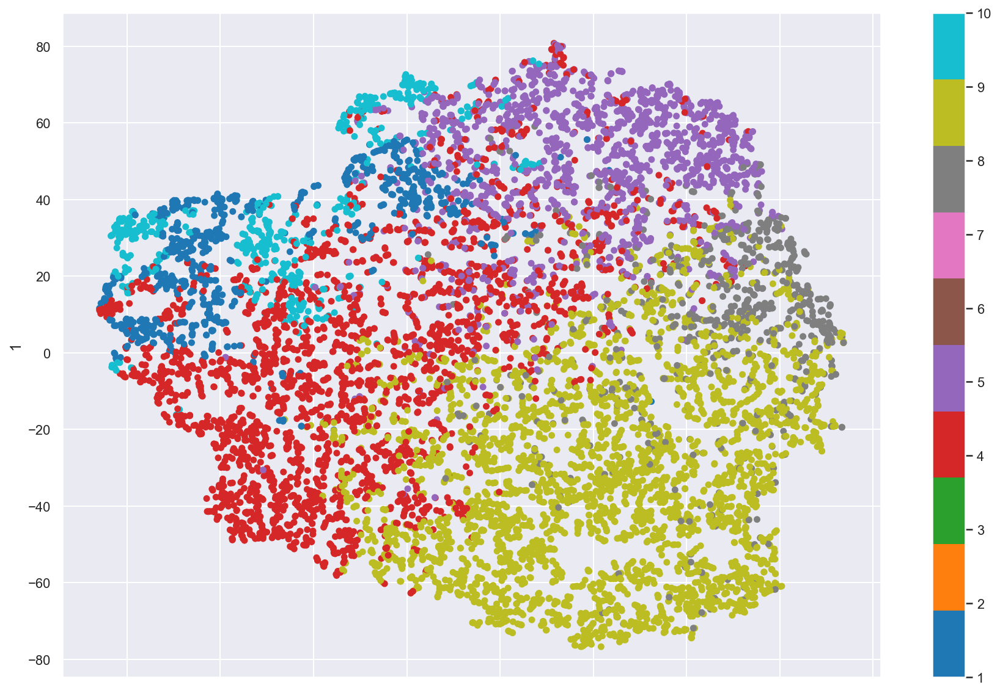

In [312]:
two_dim = TSNE(random_state=42).fit_transform(df_[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal']])

pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=df_['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

In [340]:
umap_3d = umap.UMAP(n_neighbors = 320, min_dist = 0.8, n_components=3, init='random', random_state=42)
proj_3d = umap_3d.fit_transform(df_[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal']])

fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    color=df_.merged_labels, labels={'color': 'merged_labels'}
)
fig_3d.update_traces(marker={'size': 1.7})

fig_3d.show()

In [342]:
umap_2d = umap.UMAP(n_neighbors = 200, min_dist = 0.8, n_components=2, init='random', random_state=42)
proj_2d = umap_2d.fit_transform(df_[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal']])

fig_2d = px.scatter(
    proj_2d, x=0, y=1,
    color=df_.merged_labels, labels={'color': 'merged_labels'}
)
fig_2d.update_traces(marker={'size': 4})

fig_2d.show()

<a class="anchor" id="cluster_analysis">

# 5 Final Cluster Analysis
    
</a>

In [212]:
def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profilling", fontsize=23)
    plt.show()

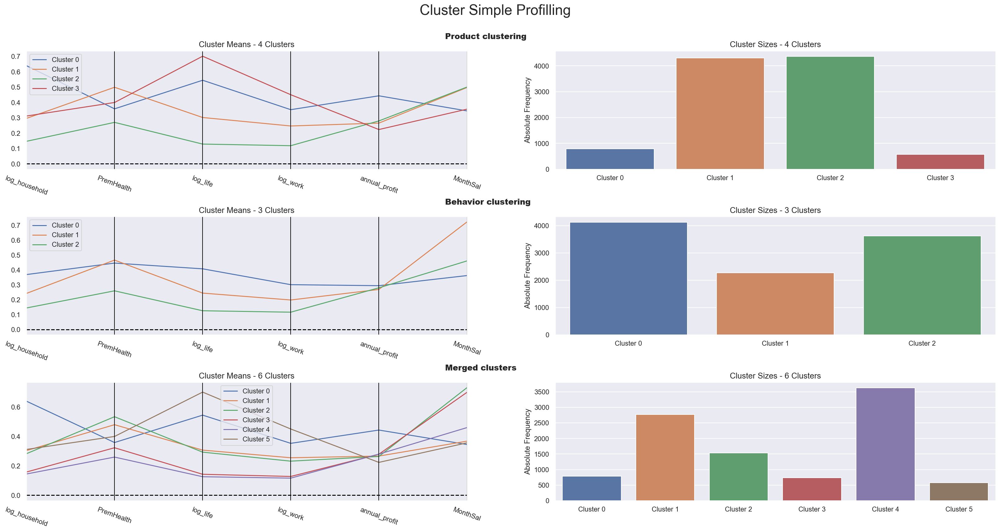

In [214]:
# Profilling each cluster (product, behavior, merged)
# VER
cluster_profiles(
    df = df_[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal']+ ['product_labels', 'social_labels', 'merged_labels']], 
    label_columns = ['product_labels', 'social_labels', 'merged_labels'], 
    figsize = (28, 13), 
    compar_titles = ["Product clustering", "Behavior clustering", "Merged clusters"]
)

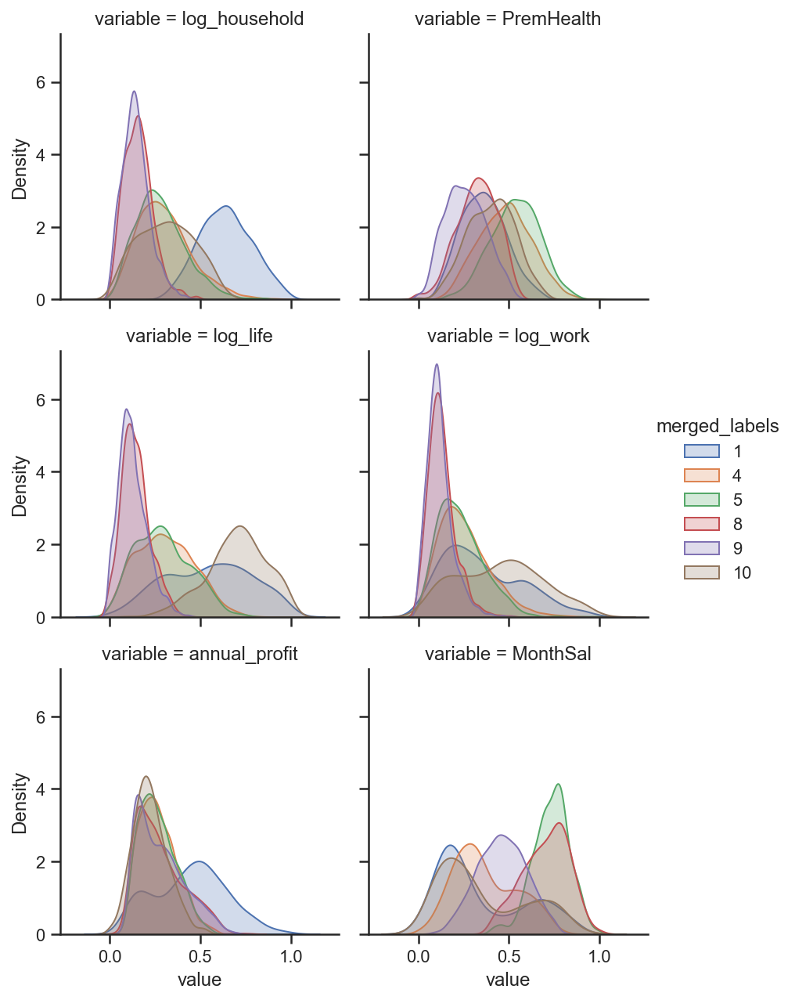

In [411]:
df = pd.melt(df_[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal', 'merged_labels']], df_[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal', 'merged_labels']].columns[-1], df_[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal', 'merged_labels']].columns[:-1])

sns.set(style="ticks", color_codes=True)
g = sns.FacetGrid(df, col="variable", hue="merged_labels", col_wrap=2)
g.map(sns.kdeplot, "value", shade=True)
g.add_legend()
plt.show()

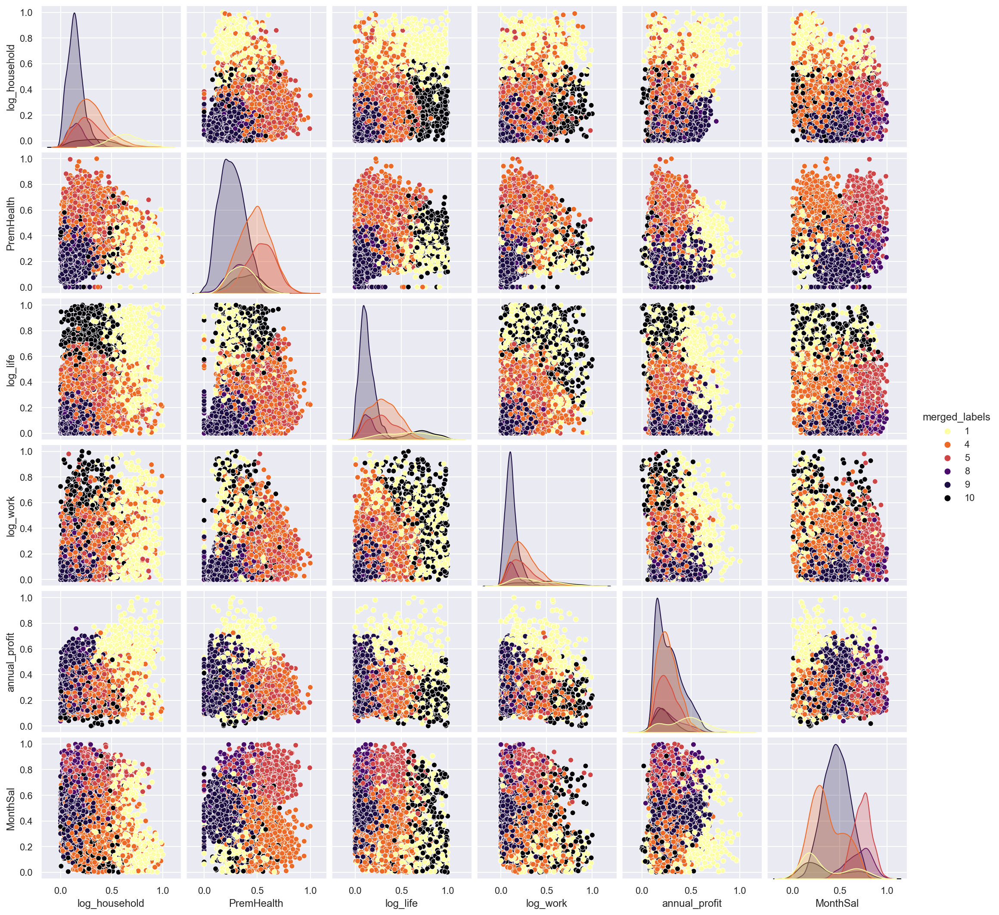

In [401]:
sns.pairplot(df_[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal', 'merged_labels']],kind='scatter',hue='merged_labels', palette = 'inferno_r')
plt.show()

<a class="anchor" id="outliers_reintroduction">

# 6 Outliers reintroduction
    
</a> 



In [215]:

# Preparing the data
X = df_.drop(columns=['social_labels','merged_labels','product_labels'])
y = df_.merged_labels

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth=4)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 81.10% of the customers correctly


In [216]:
metrics_def(y_train, dt.predict(X_train) , y_test, dt.predict(X_test))
# no overfitting

___________________________________________________________________________________________________________
                                                     TRAIN                                                 
-----------------------------------------------------------------------------------------------------------
              precision    recall  f1-score   support

           1       0.74      0.68      0.71       625
           4       0.76      0.86      0.81      2223
           5       0.74      0.93      0.82      1214
           8       0.83      0.73      0.77       600
           9       0.95      0.84      0.89      2900
          10       0.70      0.45      0.55       457

    accuracy                           0.82      8019
   macro avg       0.78      0.75      0.76      8019
weighted avg       0.82      0.82      0.82      8019

[[ 427  102   69    0    1   26]
 [  88 1907   76    3   85   64]
 [  14   27 1128   43    2    0]
 [   1    7  103  436   53    0]
 

In [217]:
# Predicting the cluster labels of the outliers
outliers['merged_labels'] = dt.predict(outliers[['log_household', 'PremHealth', 'log_life', 'log_work', 'annual_profit',
       'Children', 'EducDeg_ord', 'MonthSal']])
outliers.head()

,FirstPolYear,MonthSal,EducDeg_ord,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,...,AnnualSal,perc_inc_health,perc_inc_household,perc_inc_life,perc_inc_motor,perc_inc_work,annual_profit,Total_Premiums,anual_claims_rate,merged_labels
CustID,,,,,,,,,,,,,,,,,,,,,
14.0,0.375000,0.155327,1,3,1,0.178472,0.654321,0.072947,0.318241,0.291705,...,0.155327,0.006826,0.003876,0.028462,0.007261,0.005059,0.130272,0.987545,0.654321,10
45.0,0.458333,0.160140,3,1,1,0.149589,0.734568,0.188571,0.030465,0.472773,...,0.160140,0.010730,0.000360,0.023265,0.018207,0.002592,0.116234,0.832032,0.734568,10
52.0,0.333333,0.634653,3,4,1,-7.715917,15.654321,0.952386,0.072353,0.071173,...,0.634653,0.000408,0.000216,0.000304,0.023203,0.000035,-5.466428,0.474952,15.654321,9
109.0,0.708333,0.094290,1,4,1,0.257400,0.574074,0.133518,0.752437,0.223273,...,0.094290,0.008607,0.015097,0.037523,0.021895,0.002236,0.248007,0.948670,0.574074,1
113.0,0.958333,0.442135,4,1,1,-4.482956,9.660494,0.885335,0.060510,0.130368,...,0.442135,0.001072,0.000259,0.000396,0.030961,0.000382,-5.683370,0.491682,9.660494,9


In [218]:
df_outliers=pd.concat([outliers[['log_household', 'PremHealth', 'log_life', 'log_work', 'annual_profit',
       'Children', 'EducDeg_ord', 'MonthSal','merged_labels']],df_[['log_household', 'PremHealth', 'log_life', 'log_work', 'annual_profit',
       'Children', 'EducDeg_ord', 'MonthSal','merged_labels']]],axis=0)

C:\Users\conde\anaconda3\envs\datamining\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

C:\Users\conde\anaconda3\envs\datamining\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



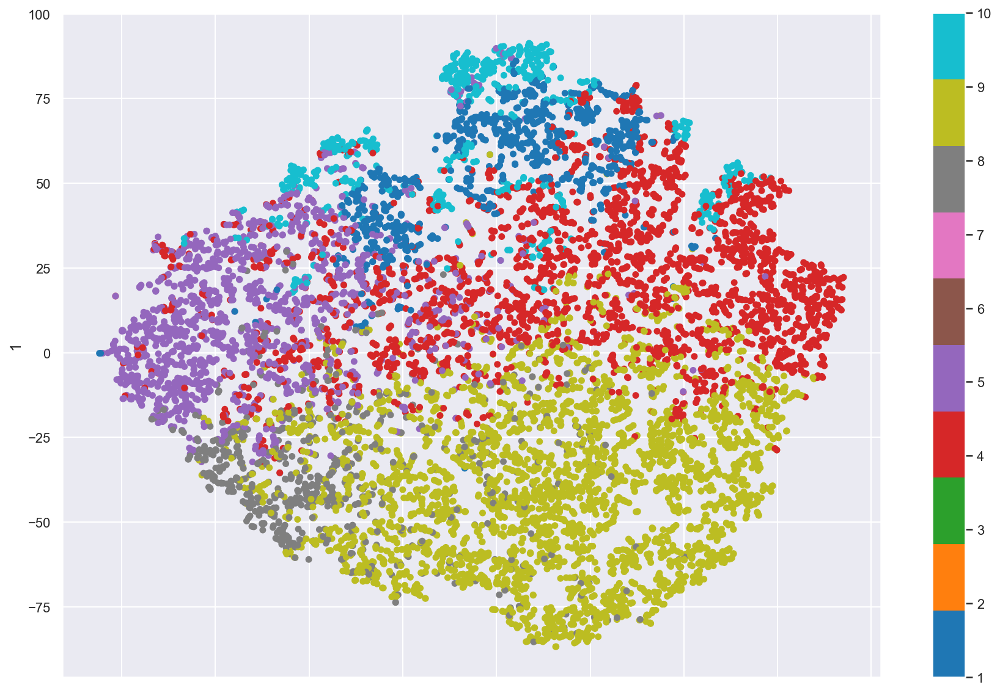

In [219]:
two_dim = TSNE(random_state=42).fit_transform(df_outliers[['log_household','PremHealth','log_life','log_work','annual_profit','MonthSal']])

pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=df_outliers['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()